# CAN Coach Bagfile Analysis

In [1]:
# Install packages and restart the kernel and don't run this next second
!pip install -U bagpy
!pip install -U strym

Requirement already up-to-date: bagpy in /home/ivory/anaconda3/envs/dbn/lib/python3.7/site-packages/bagpy-0.4.1-py3.7.egg (0.4.1)


Requirement already up-to-date: strym in /home/ivory/anaconda3/envs/dbn/lib/python3.7/site-packages/strym-0.3.1-py3.7.egg (0.3.1)


In [1]:
import bagpy
from bagpy import bagreader
import pandas as pd
import seaborn as sea
import matplotlib.pyplot as plt
import numpy as np
from strym import strymread
import ntpath
import warnings
warnings.filterwarnings("ignore")
import seaborn as sea
import os

color_long = ["#46f0f0", '#3a86ff', '#463F1A','#60492C', '#ff0022', '#208AAE', '#0D2149',\
              '#9ff9c1','#cb9173','#fdcff3',\
              '#2c80ff','#ffab2b','#fffb00', '#06b4ff','#23d160',\
              '#264653','#E9C46A',"#7900D7", "#A77500", "#6367A9", \
              "#A05837", "#772600", "#9B9700",'#E76F51',\
              '#B07BAC',"#7A87A1",'#5F7367','#472836',\
              "#00489C","#CB7E98", "#6F0062", "#EEC3FF",\
          '#97D8B2','#17BEBB','#C4A69D','#a3a271','#000000','#FFFFC7',\
          '#DB5461','#016FB9','#E56399','#D17B0F','#FFFC31','#772F1A',\
          '#808080','#000000', "#FFFF00", "#1CE6FF", "#FF34FF", "#FF4A46", \
          "#008941", "#006FA6", "#A30059","#FFDBE5", "#7A4900", "#0000A6", \
          "#63FFAC", "#B79762", "#004D43", "#8FB0FF", "#997D87","#5A0007", \
          "#809693", "#6A3A4C", "#1B4400", "#4FC601", "#3B5DFF","#4A3B53", \
          "#FF2F80","#61615A", "#BA0900", "#6B7900", "#00C2A0", "#FFAA92", "#FF90C9", \
          "#DDEFFF", "#000035", "#7B4F4B", "#A1C299", "#300018", "#0AA6D8", "#013349", "#00846F",\
          "#372101", "#FFB500", "#C2FFED", "#A079BF", "#CC0744", "#C0B9B2", "#C2FF99", "#001E09",\
          "#456D75", "#B77B68", "#788D66",\
          "#885578", "#FAD09F", "#1F819A", "#D157A0", "#BEC459", "#000080", "#0086ED", "#886F4C",\
          "#34362D", "#B4A8BD", "#00A6AA", "#452C2C", "#636375", "#A3C8C9", "#FF913F", "#938A81",\
          "#575329", "#00FECF", "#B05B6F", "#8CD0FF", "#3B9700", "#04F757", "#C8A1A1", "#1E6E00",\
          "#7900D7", "#A77500", "#6367A9", "#A05837", "#6B002C", "#772600", "#D790FF", "#9B9700",\
          "#549E79", "#FFF69F", "#201625", "#72418F", "#BC23FF", "#99ADC0", "#3A2465", "#922329",\
          "#5B4534", "#FDE8DC", "#404E55", "#0089A3", "#324E72"]

Failed to load Python extension for LZ4 support. LZ4 compression will not be available.


Loading BokehJS ...

In [4]:
DataFolder = "../Jmscslgroup/PandaData/CanCoachExperiment/"
import glob
baglist = glob.glob(DataFolder+"*.bag")
baglist  = sorted(baglist, key = lambda x: x.split('ID')[1]) 

In [5]:
baglist

['../Jmscslgroup/PandaData/CanCoachExperiment/can_coach_2020-10-12-19-08-15-ID1.bag',
 '../Jmscslgroup/PandaData/CanCoachExperiment/can_coach_2020-10-13-13-20-53-ID2.bag',
 '../Jmscslgroup/PandaData/CanCoachExperiment/can_coach_2020-10-12-18-51-06-ID3.bag',
 '../Jmscslgroup/PandaData/CanCoachExperiment/can_coach_2020-10-15-23-39-10-ID4.bag',
 '../Jmscslgroup/PandaData/CanCoachExperiment/can_coach_2020-10-16-18-38-29-ID5.bag',
 '../Jmscslgroup/PandaData/CanCoachExperiment/can_coach_2020-10-16-18-36-31-ID6.bag']

In [6]:
b0 = bagreader(baglist[0])
b1 = bagreader(baglist[1])
b2 = bagreader(baglist[2])
b3 = bagreader(baglist[3])
b4 = bagreader(baglist[4])
b5 = bagreader(baglist[5])

b0.topic_table

[INFO]  Data folder ../Jmscslgroup/PandaData/CanCoachExperiment/can_coach_2020-10-12-19-08-15-ID1 already exists. Not creating.
[INFO]  Data folder ../Jmscslgroup/PandaData/CanCoachExperiment/can_coach_2020-10-13-13-20-53-ID2 already exists. Not creating.
[INFO]  Data folder ../Jmscslgroup/PandaData/CanCoachExperiment/can_coach_2020-10-12-18-51-06-ID3 already exists. Not creating.
[INFO]  Data folder ../Jmscslgroup/PandaData/CanCoachExperiment/can_coach_2020-10-15-23-39-10-ID4 already exists. Not creating.
[INFO]  Data folder ../Jmscslgroup/PandaData/CanCoachExperiment/can_coach_2020-10-16-18-38-29-ID5 already exists. Not creating.
[INFO]  Data folder ../Jmscslgroup/PandaData/CanCoachExperiment/can_coach_2020-10-16-18-36-31-ID6 already exists. Not creating.


,Topics,Types,Message Count,Frequency
0,/ego_dist_traveled,geometry_msgs/PointStamped,6631,12.482769
1,/feedback_type,std_msgs/UInt8,6767,2.000012
2,/ghostTh,std_msgs/Float64,796,1.299754
3,/ghost_dist_traveled,geometry_msgs/PointStamped,6026,9.953142
4,/ghost_vehicle/vel,geometry_msgs/TwistStamped,21335,39.972401
5,/highbeams,geometry_msgs/Twist,3389,1.000019
6,/mode,std_msgs/UInt8,6767,2.000011
7,/modeChanger,std_msgs/Int8,301531,101.512755
8,/relv,std_msgs/Float64,15686,4.987958
9,/rosout,rosgraph_msgs/Log,1578,1.268797


In [6]:
def th_kde_plot(b):
    
    filename = ntpath.basename(b.bagfile)
    ID = filename[filename.find('ID'):filename.find('ID')+3]
    
    
    speed_file = b.message_by_topic('/vehicle/vel')
    accel_file = b.message_by_topic('/vehicle/accel')
    accel = pd.read_csv(accel_file)

    speed = pd.read_csv(speed_file)
    space_gap_file = b.message_by_topic('/space_gap')
    space_gap = pd.read_csv(space_gap_file)
    
    ghost_file = b.message_by_topic('/ghostTh')
    ghost = pd.read_csv(ghost_file)

    
    strymread.ranalyze(speed, title='Speed')
    strymread.ranalyze(space_gap, title='Space Gap')

    speed_resampled, spacegap_resampled = strymread.ts_sync(
        speed.rename(columns={"twist.linear.x": "Message"}), 
        space_gap.rename(columns={"data": "Message"}), rate = 5, method='nearest')

    fig, ax = bagpy.create_fig(1)
    ax[0].scatter( x = 'Time', y = 'twist.linear.x', data = speed, s = 3, marker = 'o', label = 'Original Speed')
    ax[0].scatter(x = 'Time', y = 'Message', data = speed_resampled,s = 1, alpha = 0.5, marker = 'x', label='Speed resampled at 5 Hz')
    ax[0].legend()
    ax[0].set_xlabel('Time')
    ax[0].set_ylabel('m/s')
    fig.show()

    fig, ax = bagpy.create_fig(1)
    ax[0].scatter( x = 'Time', y = 'data', data = space_gap, s = 3, marker = 'o', label = 'Original space gap')
    ax[0].scatter(x = 'Time', y = 'Message', data = spacegap_resampled,s = 1, alpha = 0.5, marker = 'x', 
                  label='space gap resampled at 5 Hz')
    ax[0].legend()
    ax[0].set_xlabel('Time')
    ax[0].set_ylabel('m')
    fig.show()

    timeheadway = pd.DataFrame()
    timeheadway['Time'] = spacegap_resampled['Time']
    timeheadway['Message'] = spacegap_resampled['Message']/speed_resampled['Message']
    timeheadway.replace([np.inf, -np.inf], np.nan, inplace = True)
    timeheadway.dropna(inplace=True)

    fig, ax = strymread.create_fig(1)
    ax[0].scatter(x = 'Time', y = 'Message', data= timeheadway, s = 1, c = 'Time', cmap = strymread.sunset, label = 'Time Headway')
    ax[0].legend()
    ax[0].set_xlabel('Time')
    ax[0].set_ylabel('seconds')
    ax[0].set_title(ntpath.basename(b.filename))
    fig.show()
    
    fig, ax = strymread.create_fig(1)
    ax[0].scatter(x = 'Time', y = 'accel.linear.x', data= accel, s = 1, c = 'Time', cmap = strymread.sunset, 
                  label = 'Acceleration')
    ax[0].legend()
    ax[0].set_xlabel('Time')
    ax[0].set_ylabel('seconds')
    ax[0].set_title(ntpath.basename(b.filename))
    fig.show()
    
    setpoint_file = b.message_by_topic('/setpoint')
    mode_file = b.message_by_topic('/mode')
    relv_file = b.message_by_topic('/relv')
    mode = pd.read_csv(mode_file)
    setpoint = pd.read_csv(setpoint_file)
    relv = pd.read_csv(relv_file)

    setpoint_resample, timeheadway_resampled = strymread.ts_sync(
        setpoint.rename(columns={"data": "Message"}), 
        timeheadway, rate = 1, method='nearest')

    mode_resampled, _ = strymread.ts_sync(
        mode.rename(columns={"data": "Message"}), 
        timeheadway, rate = 1, method='nearest')

    relv_resampled, _ = strymread.ts_sync(
        relv.rename(columns={"data": "Message"}), 
        setpoint_resample, rate = 'second', method='nearest')
    
    ghost_resampled, _ = strymread.ts_sync(
        ghost.rename(columns={"data": "Message"}), 
        setpoint_resample, rate = 'second', method='nearest')

    fig, ax = strymread.create_fig(1)
    ax[0].scatter(x = 'Time', y = 'Message', data = setpoint_resample, s = 1, label = 'Set Point')
    ax[0].scatter(x = 'Time', y = 'Message', data = timeheadway_resampled, s = 1, label = 'Timeheadway (s)')
    ax[0].scatter(x = 'Time', y = 'Message', data = mode_resampled, s = 1, label = 'Mode')
    ax[0].scatter(x = 'Time', y = 'Message', data = relv_resampled, s = 1, label = 'Relative Velocity')
    ax[0].scatter(x = 'Time', y = 'Message', data = ghost_resampled, s = 1, label = 'Ghost TH')
    ax[0].set_xlabel('Time')
    
    ax[0].legend()
    fig.show()


    # Construct a joint dataframe consisting of setpoints and timeheadway
    setpoint_th = pd.DataFrame()
    setpoint_th['Time'] = setpoint_resample['Time']
    setpoint_th['setpoint'] = setpoint_resample['Message']
    setpoint_th['timeheadway'] = timeheadway_resampled['Message']
    setpoint_th['mode'] = mode_resampled['Message']
    setpoint_th['relv'] = relv_resampled['Message']
    setpoint_th['ghosth'] = ghost_resampled['Message']


    modes = setpoint_th['mode'].unique()
    mode_dict = {1: 'Normal Driving', 6: 'Instructed Velocity Matching', 
            7: 'Coached Velocity Matching', 2: 'Constant Time Headway',
            3: 'Coached Constant Time Headway', 4: 'Instructed Dynamic Time Headway',
            5: 'Coach Dynamic Time Headway', 8: 'Ghost'}
    

    nc = int( np.sqrt(len(modes)))+1
    fig, ax = strymread.create_fig(ncols = 2)
    fig.set_figwidth(30)
    fig.set_figheight(12)
    k = 0
    for i, m in enumerate(modes):
        setpoint_mode = setpoint_th[setpoint_th['mode'] == m]
        
        sp = setpoint_mode['setpoint'].unique()
        for s in sp:
            sp_mode = setpoint_mode[setpoint_mode['setpoint'] == s]
#            if m == 6 or m == 7:
            #sp_mode1  = sp_mode[sp_mode.relv < sp_mode.relv.quantile(.7)]
            sp_mode1 = sp_mode[sp_mode.relv.between(sp_mode.relv.quantile(.05), sp_mode.relv.quantile(.95))] # without outliers
            sea.kdeplot(data=sp_mode1, x="relv", 
                        label = 'Mode: {}, Setpoint: {}'.format(mode_dict[m], s),
                        fill=True, common_norm=False, palette="Paired", 
                        alpha=.5, linewidth=0, ax = ax[0])
            if m == 8:
                sp_mode1 = sp_mode[sp_mode.ghosth.between(sp_mode.ghosth.quantile(.05), sp_mode.ghosth.quantile(.95))] # without outliers
                sea.kdeplot(data=sp_mode1, x="ghosth",
                            label = 'Mode: {}, Setpoint: {}'.format(mode_dict[m], s),
                            fill=True, common_norm=False, palette="Paired", 
                            alpha=.5, linewidth=0, ax = ax[1])
            else:
                sp_mode1 = sp_mode[sp_mode.timeheadway.between(sp_mode.timeheadway.quantile(.05), sp_mode.timeheadway.quantile(.95))] # without outliers
                sea.kdeplot(data=sp_mode1, x="timeheadway",
                            label = 'Mode: {}, Setpoint: {}'.format(mode_dict[m], s),
                            fill=True, common_norm=False, palette="Paired", 
                            alpha=.5, linewidth=0, ax = ax[1])
            k =k +1 
            
    ax[0].legend(loc = 'upper left', fontsize = 16)
    ax[1].legend(loc = 'upper left', fontsize = 16)
    
    ax[0].set_title("Relative Velocity Distribution")
    ax[1].set_title("Time headway Distribution")
    my_suptitle = fig.suptitle(ID, y = 1.01)
    fig.savefig('figures/densityPlot-I_{}.png'.format(ntpath.basename(b.bagfile[0:-4])),
               dpi = 100,bbox_inches='tight',bbox_extra_artists=[my_suptitle])
    fig.show()
    
    #####################################################################
    fig, ax = strymread.create_fig(nrows = nc, ncols = nc)
    fig.set_figwidth(35)
    fig.set_figheight(35)
    for i, m in enumerate(modes):
        setpoint_mode = setpoint_th[setpoint_th['mode'] == m]

        if m == 6 or m == 7:
            sea.kdeplot(data=setpoint_mode, x="relv", hue="setpoint", 
                        fill=True, common_norm=False, palette="pastel", alpha=.5, linewidth=0, ax = ax[i])
        elif m == 8:
            sea.kdeplot(data=setpoint_mode, x="ghosth", hue="setpoint", 
                        fill=True, common_norm=False, palette="pastel", alpha=.5, linewidth=0, ax = ax[i])
        else:
            sea.kdeplot(data=setpoint_mode, x="timeheadway", hue="setpoint", 
                        fill=True, common_norm=False, palette="pastel", alpha=.5, linewidth=0, ax = ax[i])
        ax[i].set_title("Mode: {}".format(mode_dict[m]))

    my_suptitle = fig.suptitle(ID, y = 1.02)
    fig.savefig('figures/densityPlot-II_{}.png'.format(ntpath.basename(b.bagfile[0:-4])),
               dpi = 100,bbox_inches='tight',bbox_extra_artists=[my_suptitle])
    fig.show()

In [82]:
def multi_bag_kde(bs):
    
    ## For relative velocity KDE plot
    fig, ax = strymread.create_fig(nrows = 4, ncols = 2)
    fig.set_figwidth(28)
    fig.set_figheight(36)
    
    ## For space gap KDE plot
    fig2, ax2 = strymread.create_fig(nrows = 4, ncols = 2)
    fig2.set_figwidth(28)
    fig2.set_figheight(36)
    
    ## For timeheadway error KDE plot
    fig3, ax3 = strymread.create_fig(nrows = 4, ncols = 2)
    fig3.set_figwidth(28)
    fig3.set_figheight(36)
    
    ## For velocity timeseries
    fig4, ax4 = strymread.create_fig(nrows = 6, ncols = 1)
    fig4.set_figwidth(20)
    fig4.set_figheight(50)
    
    ## For relative velocity timeseries
    fig5, ax5 = strymread.create_fig(nrows = 6, ncols = 1)
    fig5.set_figwidth(20)
    fig5.set_figheight(50)
    
    ## For spacegap error KDE plot
    fig6, ax6 = strymread.create_fig(nrows = 4, ncols = 2)
    fig6.set_figwidth(28)
    fig6.set_figheight(36)
    
    k = 0

    
    ID_Color = [["#ff7b00", '#3a86ff', '#297837','#60492C', '#ff0022', 
                 '#208AAE', '#0D2149', "#02c39a", "#e0aaff", "#46f0f0"],
                ['#9ff9c1','#cb9173','#fdcff3','#2c80ff','#ffab2b','#b50033']]
    
    dashes = [[1, 3, 1, 3], [3, 3, 3, 3], [8, 3, 1, 3], 
              [6, 0, 6, 1], [10, 0, 20, 0], [10, 4, 20, 1], [1, 3, 1, 3]]
    
    thickness = [3.0, 2.5, 3.0, 3.5, 4.0, 4.5, 2.0]
    
    markers = ["o", ".", "v", "8", "s", '*', "D", "H", "o"]
    
    mode_dict = {1: 'Normal Driving', 6: 'Instructed Velocity Matching', 
            7: 'Coached Velocity Matching', 2: 'Constant Time Headway',
            3: 'Coached Constant Time Headway', 4: 'Instructed Dynamic Time Headway',
            5: 'Coach Dynamic Time Headway', 8: 'Ghost'}
    

    
    for b in bs:
        filename = ntpath.basename(b.bagfile)
        ID = filename[filename.find('ID'):filename.find('ID')+3]
        CID = int(ID[2:])-1
        speed_file = b.message_by_topic('/vehicle/vel')
        speed = pd.read_csv(speed_file)
        space_gap_file = b.message_by_topic('/space_gap')
        space_gap = pd.read_csv(space_gap_file)
        ghost_file = b.message_by_topic('/ghostTh')
        ghost = pd.read_csv(ghost_file)

        ghostvel_file = b.message_by_topic('/ghost_vehicle/vel')
        ghostvel = pd.read_csv(ghostvel_file)
    
        speed_resampled, spacegap_resampled = strymread.ts_sync(
            speed.rename(columns={"twist.linear.x": "Message"}), 
            space_gap.rename(columns={"data": "Message"}), rate = 5, method='nearest')
        
        timeheadway = pd.DataFrame()
        timeheadway['Time'] = spacegap_resampled['Time']
        timeheadway['Message'] = spacegap_resampled['Message']/speed_resampled['Message']
        timeheadway.replace([np.inf, -np.inf], np.nan, inplace = True)
        timeheadway.dropna(inplace=True)
        
        setpoint_file = b.message_by_topic('/setpoint')
        mode_file = b.message_by_topic('/mode')
        relv_file = b.message_by_topic('/relv')
        mode = pd.read_csv(mode_file)
        setpoint = pd.read_csv(setpoint_file)
        relv = pd.read_csv(relv_file)

        setpoint_resample, timeheadway_resampled = strymread.ts_sync(
            setpoint.rename(columns={"data": "Message"}), 
            timeheadway, rate = 1, method='nearest')
        
        setpoint_resample, timeheadway_resampled = strymread.ts_sync(
            setpoint.rename(columns={"data": "Message"}), 
            timeheadway, rate = 1, method='nearest')
        

        mode_resampled, _ = strymread.ts_sync(
            mode.rename(columns={"data": "Message"}), 
            timeheadway, rate = 1, method='nearest')
        

        spacegap_resampled, _ = strymread.ts_sync(
            space_gap.rename(columns={"data": "Message"}), 
            setpoint_resample, rate = 'second', method='nearest')
        
        relv_resampled, _ = strymread.ts_sync(
            relv.rename(columns={"data": "Message"}), 
            setpoint_resample, rate = 'second', method='nearest')

        ghost_resampled, _ = strymread.ts_sync(
            ghost.rename(columns={"data": "Message"}), 
            setpoint_resample, rate = 'second', method='nearest')
        
        speed_resampled, _ = strymread.ts_sync(
            speed.rename(columns={"twist.linear.x": "Message"}), 
            setpoint_resample, rate = 'second', method='nearest')
        
        ghostvel_resampled, _ = strymread.ts_sync(
            ghostvel.rename(columns={"twist.linear.x": "Message"}), 
            setpoint_resample, rate = 'second', method='nearest')
        
        # Construct a joint dataframe consisting of setpoints and timeheadway
        setpoint_th = pd.DataFrame()
        setpoint_th['Time'] = setpoint_resample['Time']
        setpoint_th['setpoint'] = setpoint_resample['Message']
        setpoint_th['timeheadway'] = timeheadway_resampled['Message']
        setpoint_th['mode'] = mode_resampled['Message']
        setpoint_th['relv'] = relv_resampled['Message']
        setpoint_th['ghosth'] = ghost_resampled['Message']
        setpoint_th['spacegap'] = spacegap_resampled['Message']
        setpoint_th['speed'] = speed_resampled['Message']
        setpoint_th['ghostvel'] = ghostvel_resampled['Message']
        
        setpoint_th['desired_spacegap'] = setpoint_th['setpoint']*(setpoint_th['speed'] + setpoint_th['relv'])
        setpoint_th['spacegap_error'] = setpoint_th['desired_spacegap'] - setpoint_th['spacegap']
        
        # Remove outliers based on speed measurement
        setpoint_th = setpoint_th[setpoint_th.speed.between
                             (
                            setpoint_th.speed.quantile(.10), setpoint_th.speed.quantile(1)
                            )
                        ]
        
        setpoint_th = setpoint_th[setpoint_th.relv.between
                             (
                            setpoint_th.relv.quantile(.05), setpoint_th.relv.quantile(0.99)
                            )
                        ]
        
        print(setpoint_th.shape)

        modes = setpoint_th['mode'].unique()
        
        for i, m in enumerate(modes):
            m = int(m)
            setpoint_mode = setpoint_th[setpoint_th['mode'] == m]
            sp = setpoint_mode['setpoint'].unique()
            
            sp_mode = setpoint_mode
            if m == 6 or m == 7:

                sp_mode1 = sp_mode.iloc[10:]
                
                mean = np.mean(sp_mode1["relv"])
                stddev = np.std(sp_mode1["relv"])
                
                sea.kdeplot(data=sp_mode1["relv"], #x="relv", 
                            label = '{}, mean = {:.2f}, std = {:.2f}'.format(ID, mean, stddev),
                            dashes = dashes[CID],
                            fill=False, common_norm=False,
                            alpha=.75, linewidth=thickness[CID], ax = ax[i], color = ID_Color[0][CID])
                
                ax[i].set_xlabel("Relative velocity")
                
                mean = np.mean(sp_mode1["spacegap"])
                stddev = np.std(sp_mode1["spacegap"])
                
                sea.kdeplot(data=sp_mode1, x="spacegap", 
                            label = '{}, mean = {:.2f}, std = {:.2f}'.format(ID, mean, stddev),
                            dashes = dashes[CID],
                            fill=False, common_norm=False,
                            alpha=.75, linewidth=thickness[CID], ax = ax2[i], color = ID_Color[0][CID])
                
                ax2[i].set_xlabel("Space gap")
                
                mean = np.mean(sp_mode1["timeheadway"])
                stddev = np.std(sp_mode1["timeheadway"])
                
                sea.kdeplot(data=sp_mode1, x="timeheadway", 
                            label = '{}, mean = {:.2f}, std = {:.2f}'.format(ID, mean, stddev),
                            dashes = dashes[CID],
                            fill=False, common_norm=False,
                            alpha=.75, linewidth=thickness[CID], ax = ax3[i], color = ID_Color[0][CID])
                
                ax3[i].set_xlabel("Time gap")
                
                ax4[CID].plot(sp_mode1['Time'], sp_mode1['speed'], markersize = 5, marker =  markers[m],
                               color = ID_Color[0][m], linewidth = 0, 
                               label = '{}'.format(mode_dict[m]))
                
#                 ax4[CID].scatter(x ='Time', y = 'speed', s = 20, marker =  markers[m],
#                                c = ID_Color[0][m],data = sp_mode1,alpha = 0.6,
#                                label = '{}'.format(mode_dict[m]))
                ax4[CID].set_ylabel("Speed (m/s)")
                ax4[CID].set_xlabel("Time")
                
#                 ax5[CID].scatter(x ='Time', y = 'relv', s = 20, marker =  markers[m],
#                                c = ID_Color[0][m],data = sp_mode1,alpha = 0.6,
#                                label = '{}'.format(mode_dict[m]))
                
                ax5[CID].plot(sp_mode1['Time'], sp_mode1['relv'], markersize = 5, marker =  markers[m],
                               color = ID_Color[0][m], linewidth = 0, 
                               label = '{}'.format(mode_dict[m]))
                
                ax5[CID].set_ylabel("Relative velocity (m/s)")
                ax5[CID].set_xlabel("Time")
                
                mean = np.mean(sp_mode1["spacegap_error"])
                stddev = np.std(sp_mode1["spacegap_error"])
                
                sea.kdeplot(data=sp_mode1, x="spacegap_error", 
                            label = '{}, mean = {:.2f}, std = {:.2f}'.format(ID, mean, stddev),
                            dashes = dashes[CID],
                            fill=False, common_norm=False,
                            alpha=.75, linewidth=thickness[CID], ax = ax6[i], color = ID_Color[0][CID])
                
                ax6[i].set_xlabel("Space gap error")
                
                
            elif m == 8:

                if len(sp_mode.setpoint.unique())  == 1:
                    sp_mode1 = sp_mode.iloc[10:]
                else:
                    sp_mode1 = sp_mode[sp_mode.setpoint == 2.25]
                    sp_mode2 = sp_mode[sp_mode.setpoint == 1.8]

                    assert(len(sp_mode1.setpoint.unique())  == 1), 'Problem filtering on setpoint 2.25'
                    assert(len(sp_mode2.setpoint.unique())  == 1), 'Problem filtering on setpoint 1.8'

                    sp_mode1 = pd.concat([sp_mode1, sp_mode2])
                
                mean = np.mean(sp_mode1["relv"])
                stddev = np.std(sp_mode1["relv"])
                
                sea.kdeplot(data=sp_mode1["relv"], #x="relv", 
                            label = '{}, mean = {:.2f}, std = {:.2f}'.format(ID, mean, stddev),
                            dashes = dashes[CID],
                            fill=False, common_norm=False,
                            alpha=.75, linewidth=thickness[CID], ax = ax[i], color = ID_Color[0][CID])
                
                ax[i].set_xlabel("Relative velocity")
                
                mean = np.mean(sp_mode1["spacegap"])
                stddev = np.std(sp_mode1["spacegap"])
                
                
                sea.kdeplot(data=sp_mode1, x="spacegap", 
                            label = '{}, mean = {:.2f}, std = {:.2f}'.format(ID, mean, stddev),
                            dashes = dashes[CID],
                            fill=False, common_norm=False,
                            alpha=.75, linewidth=thickness[CID], ax = ax2[i], color = ID_Color[0][CID])
                
                ax2[i].set_xlabel("Space gap")
                
                mean = np.mean(sp_mode1["ghosth"] - sp_mode1['setpoint'])
                stddev = np.std(sp_mode1["ghosth"] - sp_mode1['setpoint'])
                
                sea.kdeplot(data=sp_mode1["ghosth"] - sp_mode1['setpoint'],dashes = dashes[CID],
                            label = '{}, mean = {:.2f}, std = {:.2f}'.format(ID, mean, stddev),
                            fill=False, common_norm=False, 
                            alpha=.75, linewidth=4, ax = ax3[i], color = ID_Color[0][int(ID[2:])-1])
                ax3[i].set_xlabel("Ghost Timegap Error")
                
#                 ax4[CID].scatter(x ='Time', y = 'speed', s = 20, marker =  markers[m],
#                                c = ID_Color[0][m],data = sp_mode1,alpha = 0.6,
#                                label = '{}'.format(mode_dict[m]))
                
                ax4[CID].plot(sp_mode1['Time'], sp_mode1['speed'], markersize = 5, marker =  markers[m],
                               color = ID_Color[0][m],  linewidth = 0, 
                               label = '{}'.format(mode_dict[m]))
                
                ax4[CID].set_ylabel("Speed (m/s)")
                ax4[CID].set_xlabel("Time")

#                 ax5[CID].scatter(x ='Time', y = 'relv', s = 20, marker =  markers[m],
#                                c = ID_Color[0][m],data = sp_mode1,alpha = 0.6,
#                                label = '{}'.format(mode_dict[m]))
                
                ax5[CID].plot(sp_mode1['Time'], sp_mode1['relv'], markersize = 5, marker =  markers[m],
                               color = ID_Color[0][m],  linewidth = 0, 
                               label = '{}'.format(mode_dict[m]))
                
                ax5[CID].set_ylabel("Relative velocity (m/s)")
                ax5[CID].set_xlabel("Time")
                
                ghost_space_gap_error = (sp_mode1["setpoint"]*sp_mode1["ghostvel"]) - sp_mode1['spacegap']
                
                mean = np.mean(ghost_space_gap_error)
                stddev = np.std(ghost_space_gap_error)
                
                sea.kdeplot(data=sp_mode1, x=ghost_space_gap_error, 
                            label = '{}, mean = {:.2f}, std = {:.2f}'.format(ID, mean, stddev),
                            dashes = dashes[CID],
                            fill=False, common_norm=False,
                            alpha=.75, linewidth=thickness[CID], ax = ax6[i], color = ID_Color[0][CID])
                
                ax6[i].set_xlabel("Ghost space gap error")
                
            else:              
                
                if len(sp_mode.setpoint.unique())  == 1:
                    sp_mode1 = sp_mode.iloc[10:]
                else:
                    sp_mode1 = sp_mode[sp_mode.setpoint == 2.25]
                    sp_mode1 = sp_mode1.iloc[10:]
                    sp_mode2 = sp_mode[sp_mode.setpoint == 1.8]
                    sp_mode2 = sp_mode2.iloc[10:]
                    assert(len(sp_mode1.setpoint.unique())  == 1), 'Problem filtering on setpoint 2.25'
                    assert(len(sp_mode2.setpoint.unique())  == 1), 'Problem filtering on setpoint 1.8'

                    sp_mode1 = pd.concat([sp_mode1, sp_mode2])
                    
                    
                mean = np.mean(sp_mode1["relv"])
                stddev = np.std(sp_mode1["relv"])
                
                sea.kdeplot(data=sp_mode1["relv"], #x="relv", 
                            label = '{}, mean = {:.2f}, std = {:.2f}'.format(ID, mean, stddev),
                            dashes = dashes[CID],
                            fill=False, common_norm=False,
                            alpha=.75, linewidth=thickness[CID], ax = ax[i], color = ID_Color[0][CID])
                
                ax[i].set_xlabel("Relative velocity")
                
                mean = np.mean(sp_mode1["spacegap"])
                stddev = np.std(sp_mode1["spacegap"])
                
                sea.kdeplot(data=sp_mode1, x="spacegap", 
                            label = '{}, mean = {:.2f}, std = {:.2f}'.format(ID, mean, stddev),
                            dashes = dashes[CID],
                            fill=False, common_norm=False,
                            alpha=.75, linewidth=thickness[CID], ax = ax2[i], color = ID_Color[0][CID])
                
                ax2[i].set_xlabel("Space gap")
                
                
                mean = np.mean(sp_mode1["timeheadway"] - sp_mode1['setpoint'])
                stddev = np.std(sp_mode1["timeheadway"] - sp_mode1['setpoint'])
                sea.kdeplot(data=sp_mode1["timeheadway"]- sp_mode1['setpoint'], dashes = dashes[CID],
                            label = '{}, mean = {:.2f}, std = {:.2f}'.format(ID, mean, stddev),
                            fill=False, common_norm=False, 
                        alpha=.75, linewidth=4, ax = ax3[i], color = ID_Color[0][int(ID[2:])-1])
                
                
                ax3[i].set_xlabel("Timegap Error")
                if m == 1:
                    ax3[i].set_xlabel("Timegap")
                    
                ax4[CID].plot(sp_mode1['Time'], sp_mode1['speed'], markersize = 5, marker =  markers[m],
                               color = ID_Color[0][m], linewidth = 0, 
                               label = '{}'.format(mode_dict[m]))
                
#                 ax4[CID].scatter(x ='Time', y = 'speed', s = 20, marker =  markers[m],
#                                c = ID_Color[0][m],data = sp_mode1, alpha = 0.6,
#                                label = '{}'.format(mode_dict[m]))


                ax4[CID].set_ylabel("Speed (m/s)")
                ax4[CID].set_xlabel("Time")
                
#                 ax5[CID].scatter(x ='Time', y = 'relv', s = 20, marker =  markers[m],
#                                c = ID_Color[0][m],data = sp_mode1,alpha = 0.6,
#                                label = '{}'.format(mode_dict[m]))
                
                ax5[CID].plot(sp_mode1['Time'], sp_mode1['relv'], markersize = 5, marker =  markers[m],
                               color = ID_Color[0][m], linewidth = 0, 
                               label = '{}'.format(mode_dict[m]))
                
                ax5[CID].set_ylabel("Relative velocity (m/s)")
                ax5[CID].set_xlabel("Time")
                
                mean = np.mean(sp_mode1["spacegap_error"])
                stddev = np.std(sp_mode1["spacegap_error"])
                
                sea.kdeplot(data=sp_mode1, x="spacegap_error", 
                            label = '{}, mean = {:.2f}, std = {:.2f}'.format(ID, mean, stddev),
                            dashes = dashes[CID],
                            fill=False, common_norm=False,
                            alpha=.75, linewidth=thickness[CID], ax = ax6[i], color = ID_Color[0][CID])
                
                ax6[i].set_xlabel("Space gap error")
                
                k = k + 1
            ax[i].set_title("Mode: {}".format(mode_dict[m]))
            ax[i].set_xlim(-6, 6)
            ax[i].set_ylim(0, 1.5)
            
            ax2[i].set_title("Mode: {}".format(mode_dict[m]))
            ax2[i].set_xlim(-1, 200)
            ax2[i].set_ylim(0, 0.25)
            
            ax3[i].set_title("Mode: {}".format(mode_dict[m]))
            ax3[i].set_xlim(-1, 8)
            ax3[i].set_ylim(0, 7.0)
            
            ax4[CID].set_title("{}".format(ID))
            ax5[CID].set_title("{}".format(ID))
            
            ax[i].legend(loc = 'upper right', fontsize = 20)
            ax2[i].legend(loc = 'upper right', fontsize = 20)
            ax3[i].legend(loc = 'upper right', fontsize = 20)
            ax4[CID].legend(loc = 'upper right', fontsize = 20, markerscale = 2, ncol=2)
            ax5[CID].legend(loc = 'upper right', fontsize = 20, markerscale = 2, ncol=2)
            
            ax4[CID].set_xlim(np.min(setpoint_th['Time'])-10, np.max(setpoint_th['Time'])+10)
            ax4[CID].set_ylim(np.min(setpoint_th['speed'])-15, np.max(setpoint_th['speed'])+15)
            ax5[CID].set_xlim(np.min(setpoint_th['Time'])-10, np.max(setpoint_th['Time'])+10)
            ax5[CID].set_ylim(np.min(setpoint_th['relv'])-5, np.max(setpoint_th['relv'])+5)
                
            ax6[i].set_title("Mode: {}".format(mode_dict[m]))
            ax6[i].set_xlim(-140, 140.0)
            ax6[i].set_ylim(0, 0.25)
                
#             if m == 6 or m == 7:
#                 ax2[int(7-m)].legend(loc = 'upper right', fontsize = 20)
#                 ax2[int(7-m)].set_title("Mode: {}".format(mode_dict[m]))
                
    
    my_suptitle = fig.suptitle('Aggregated Density Plot: relative velocity', y = 1.01)
    fig.savefig('figures/densityPlot-Aggregated-relv.png',
               dpi = 100,bbox_inches='tight',bbox_extra_artists=[my_suptitle])
    fig.show()
    
    my_suptitle2 = fig2.suptitle('Aggregated Density Plot: space gap', y = 1.01)
    fig2.tight_layout()
    fig2.savefig('figures/densityPlot-Aggregated-spacegap.png',
               dpi = 100,bbox_inches='tight',bbox_extra_artists=[my_suptitle2])
    fig2.show()
    
    my_suptitle3 = fig3.suptitle('Aggregated Density Plot: timegap error/timegap', y = 1.01)
    fig3.tight_layout()
    fig3.savefig('figures/densityPlot-Aggregated-timegap.png',
               dpi = 100,bbox_inches='tight',bbox_extra_artists=[my_suptitle3])
    fig3.show()
    
    my_suptitle4 = fig4.suptitle('Speed Timeseries', y = 1.02)
    fig4.tight_layout()
    fig4.savefig('figures/speed-timeseries.png',
               dpi = 100,bbox_inches='tight',bbox_extra_artists=[my_suptitle4])
    fig4.show()
    
    my_suptitle5 = fig5.suptitle('Relative Velocity Timeseries', y = 1.01)
    fig5.tight_layout()
    fig5.savefig('figures/relspeed-timeseries.png',
               dpi = 100,bbox_inches='tight',bbox_extra_artists=[my_suptitle5])
    fig5.show()
    
    my_suptitle6 = fig6.suptitle('Aggregated Density Plot: space gap error', y = 1.01)
    fig6.tight_layout()
    fig6.savefig('figures/densityPlot-Aggregated-spacegap_error.png',
               dpi = 100,bbox_inches='tight',bbox_extra_artists=[my_suptitle6])
    fig6.show()

    return setpoint_th

## Specific Analysis
### Bag File with ID-1
### Time headway plot, KDE plot

Analyzing Timestamp and Data Rate of Speed
Interquartile Range of Rate for Speed is 7.414480498450693 


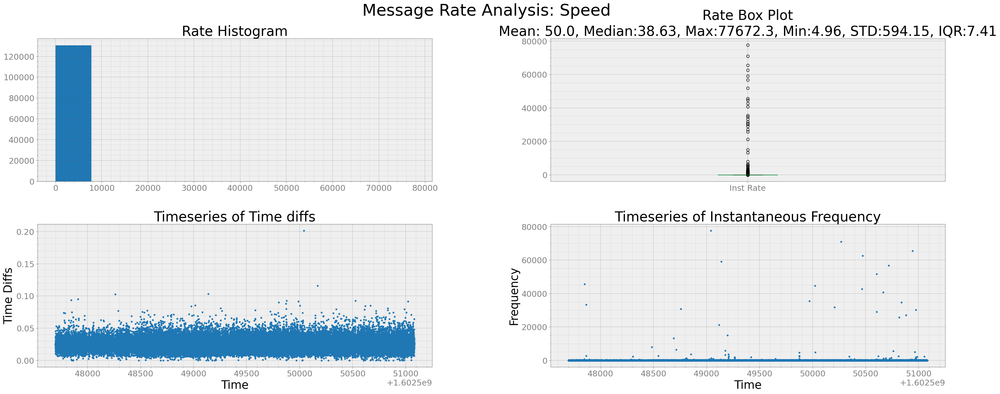

Analyzing Timestamp and Data Rate of Space Gap
Interquartile Range of Rate for Space Gap is 0.23320891629748353 


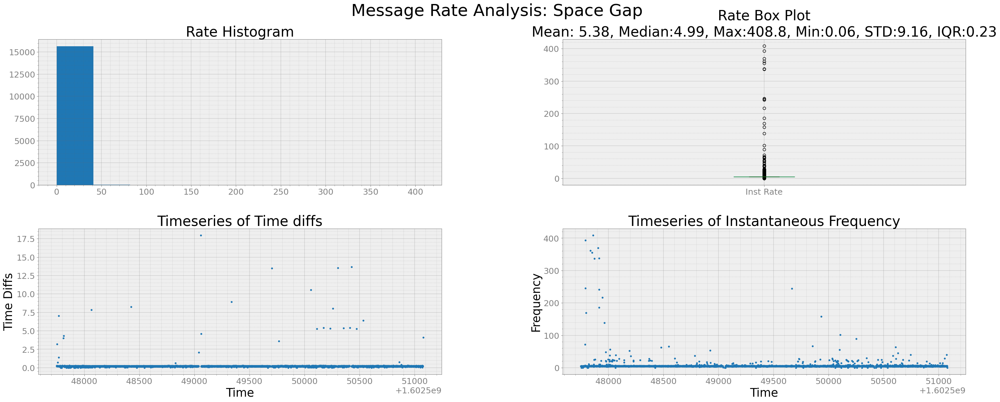

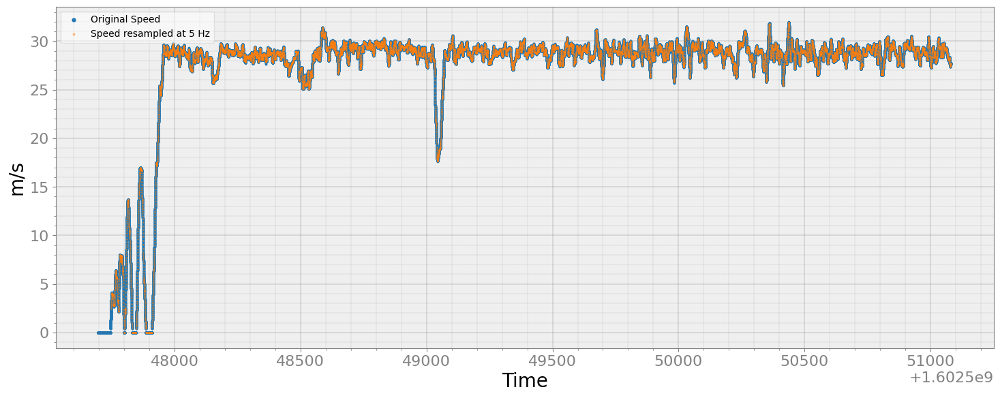

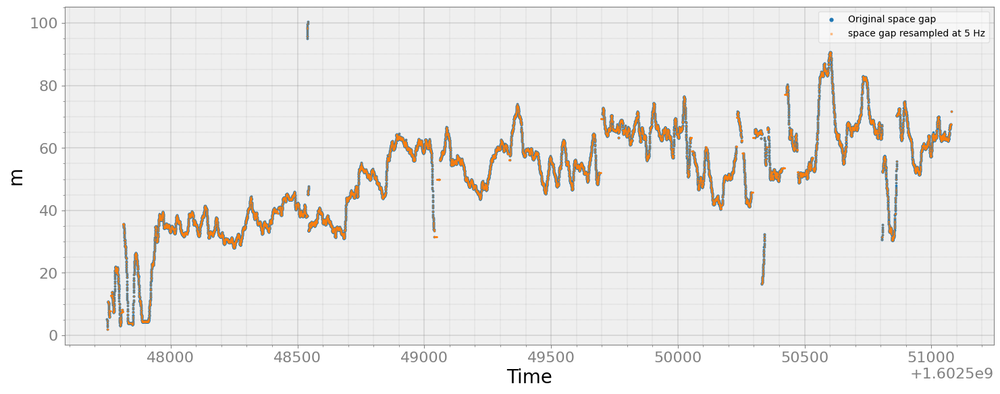

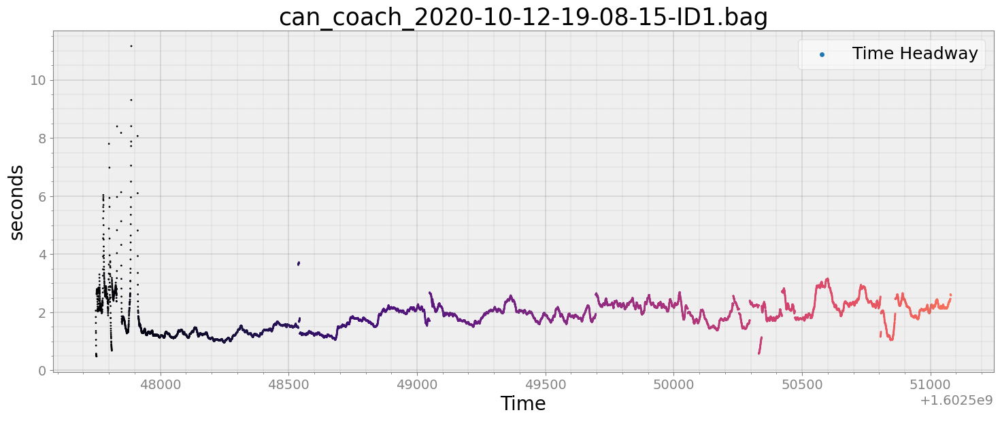

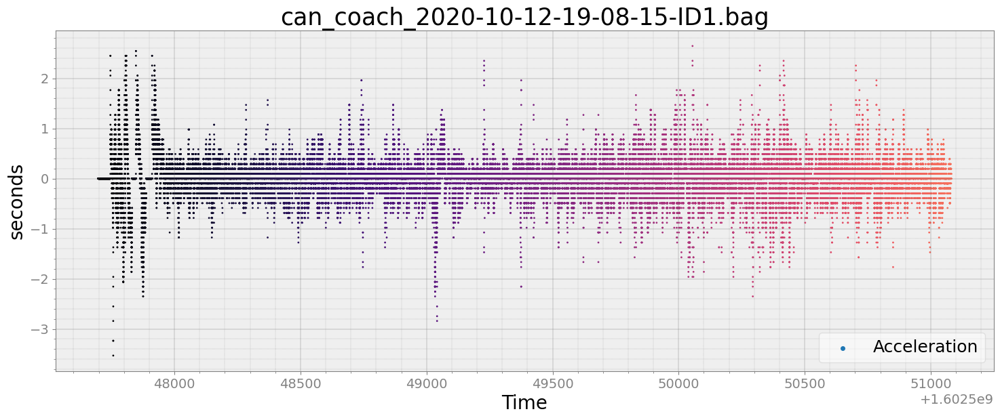

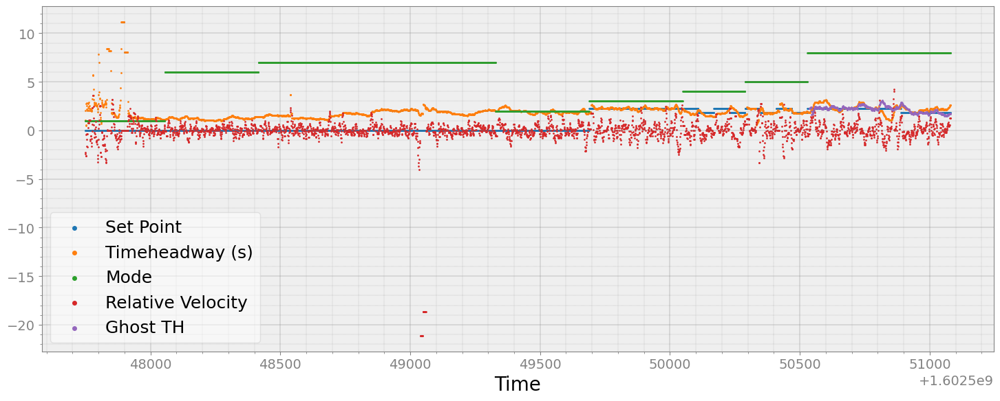

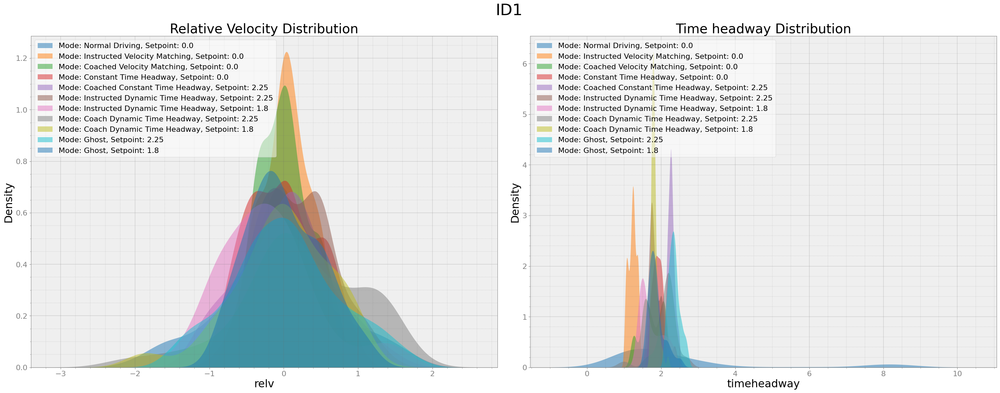

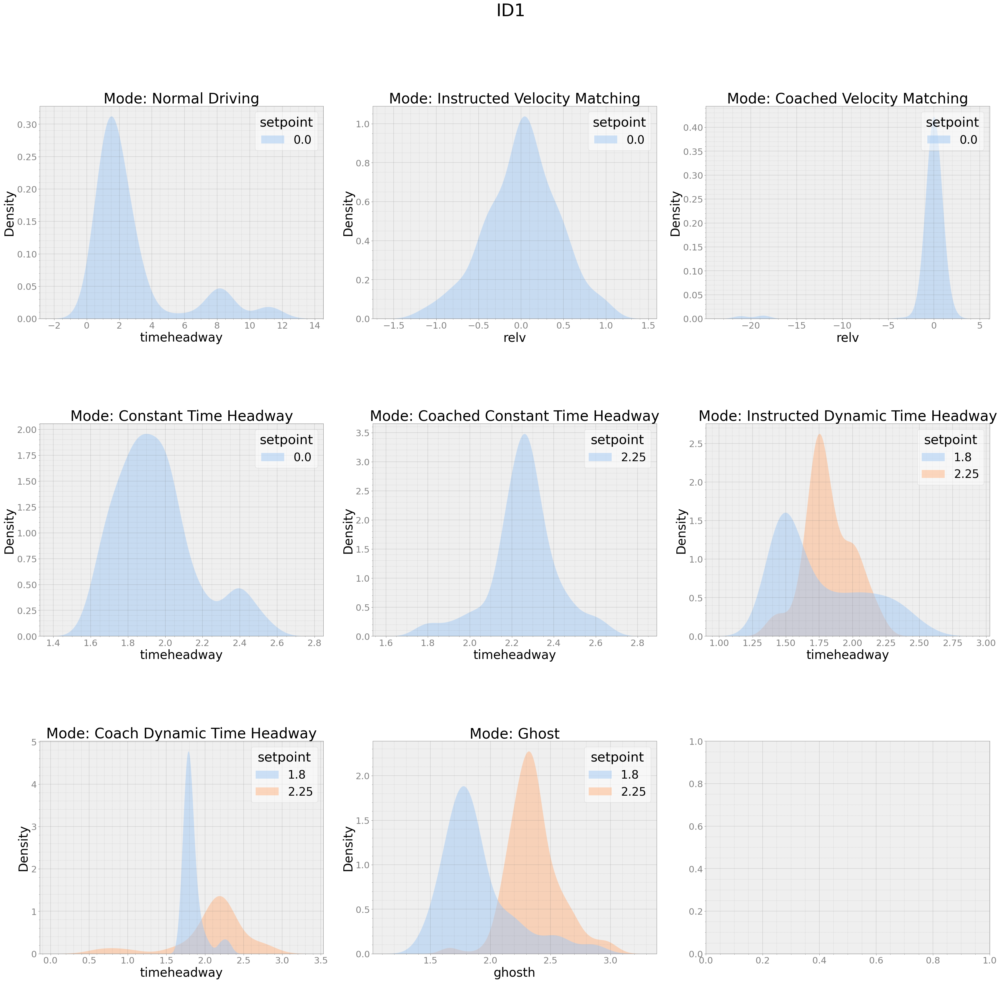

In [8]:
th_kde_plot(b0)

### Bag File with ID-2
### Time headway plot, KDE plot

Analyzing Timestamp and Data Rate of Speed
Interquartile Range of Rate for Speed is 9.339122652529781 


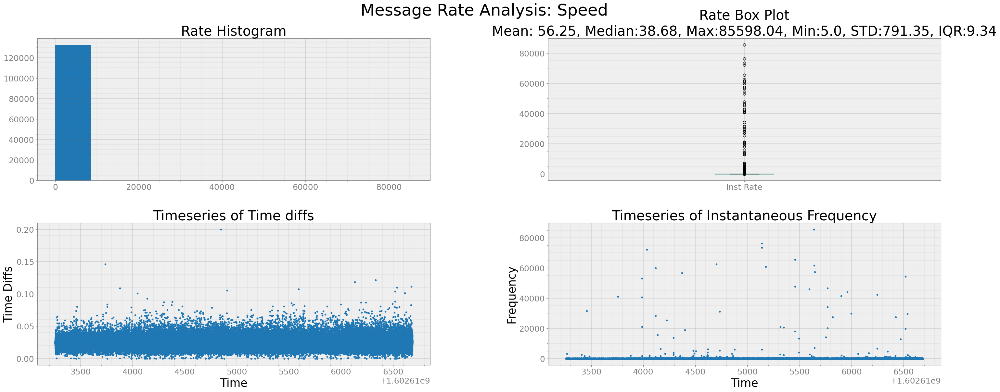

Analyzing Timestamp and Data Rate of Space Gap
Interquartile Range of Rate for Space Gap is 0.2818089978300389 


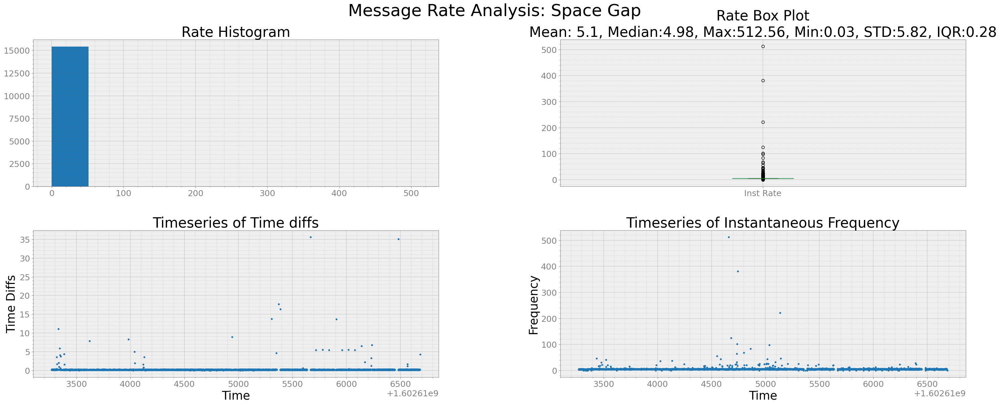

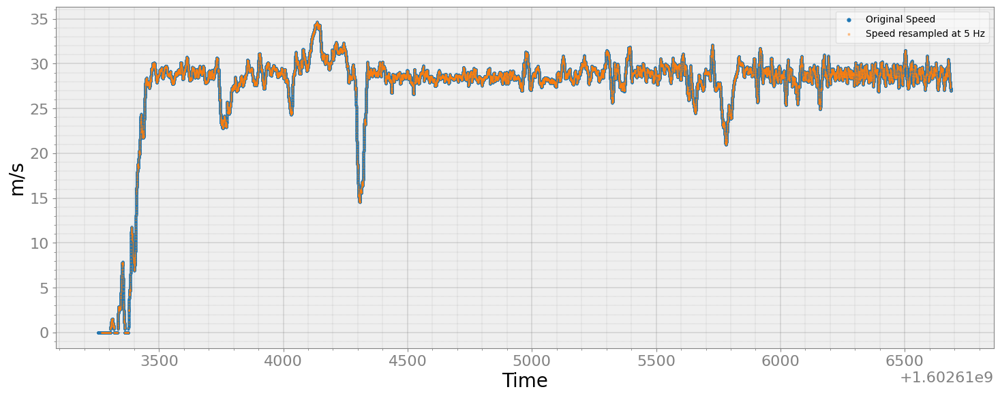

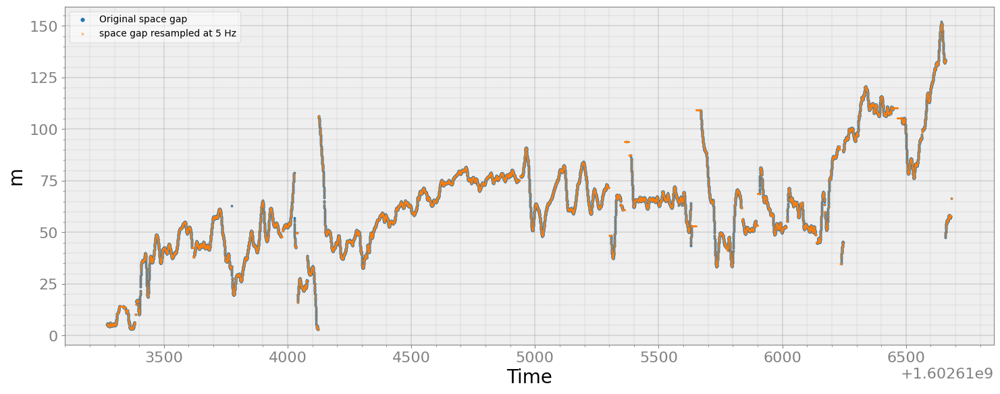

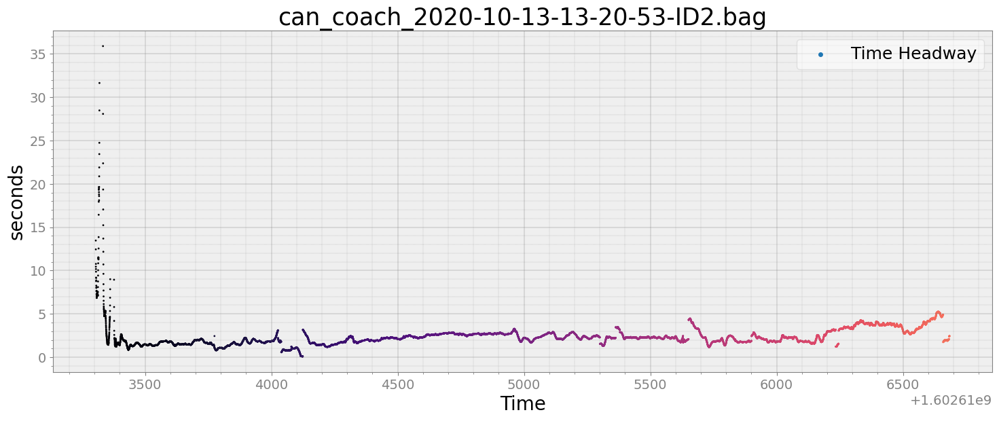

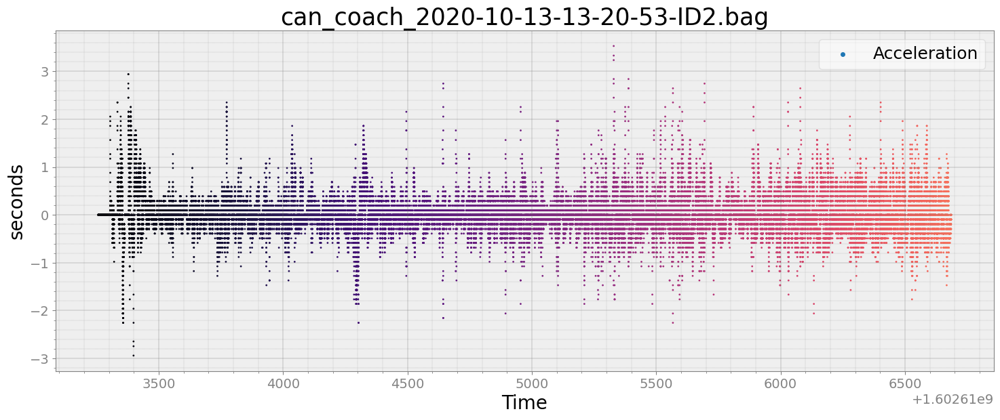

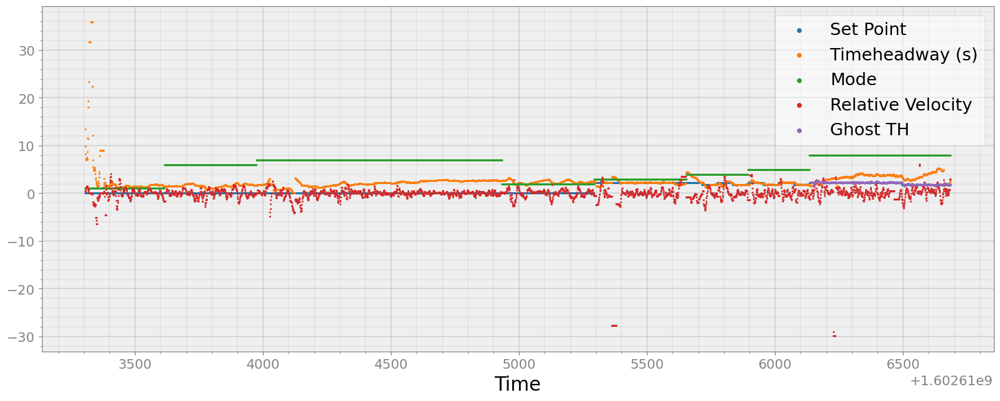

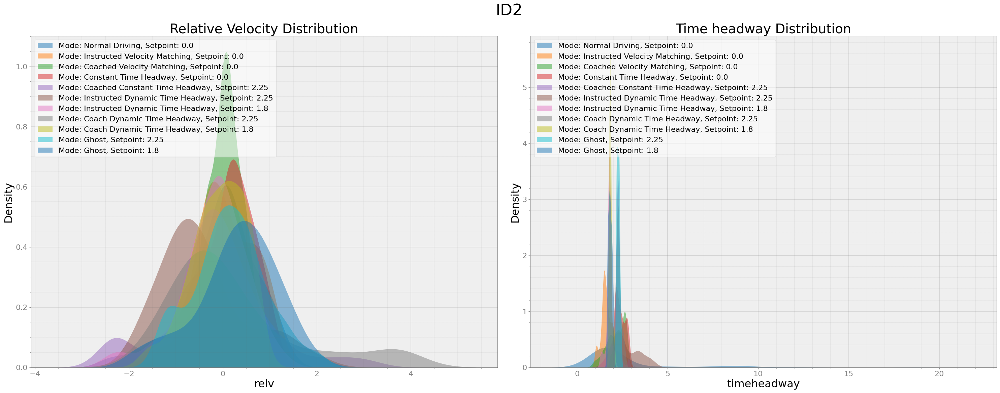

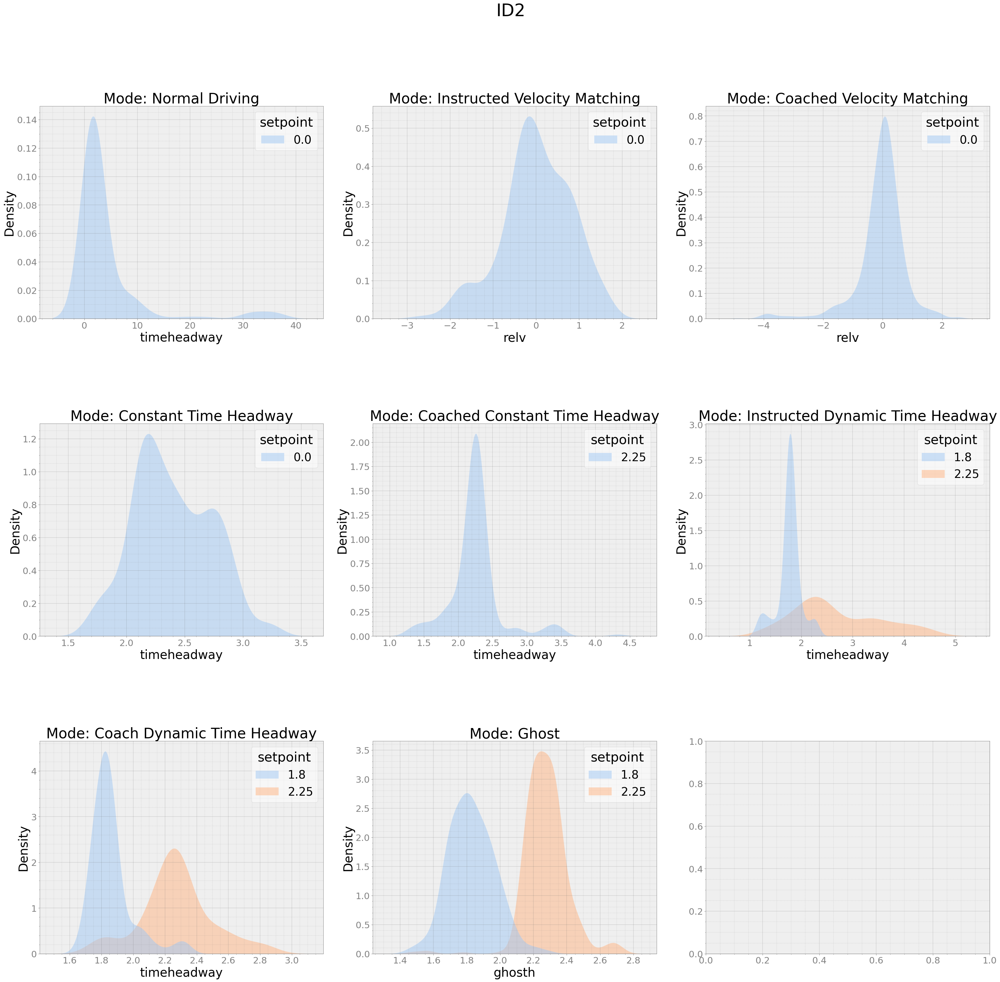

In [9]:
th_kde_plot(b1)

### Bag File with ID-3
### Time headway plot, KDE plot

Analyzing Timestamp and Data Rate of Speed
Interquartile Range of Rate for Speed is 8.258500774138874 


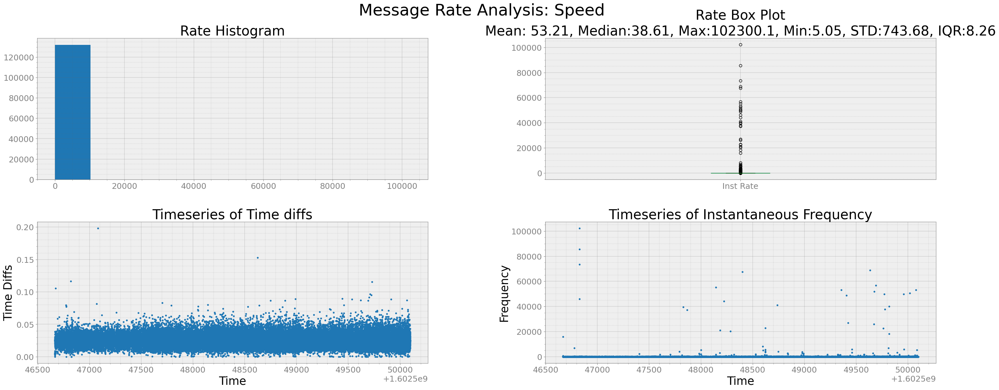

Analyzing Timestamp and Data Rate of Space Gap
Interquartile Range of Rate for Space Gap is 0.26193492586543066 


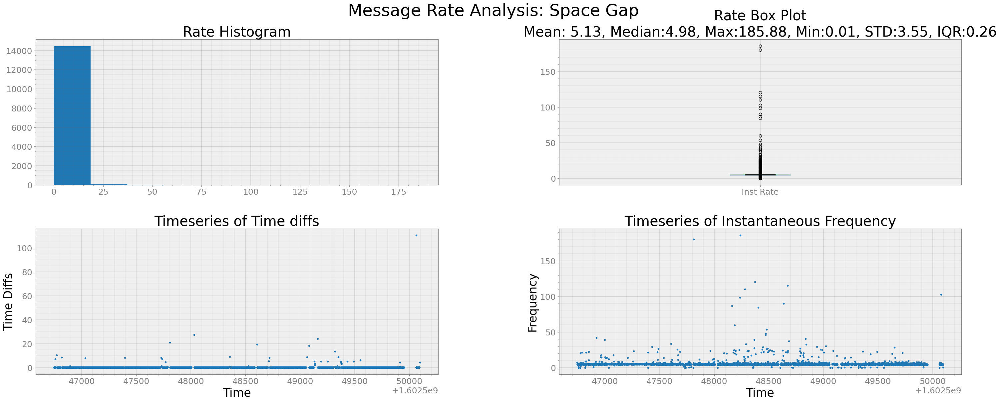

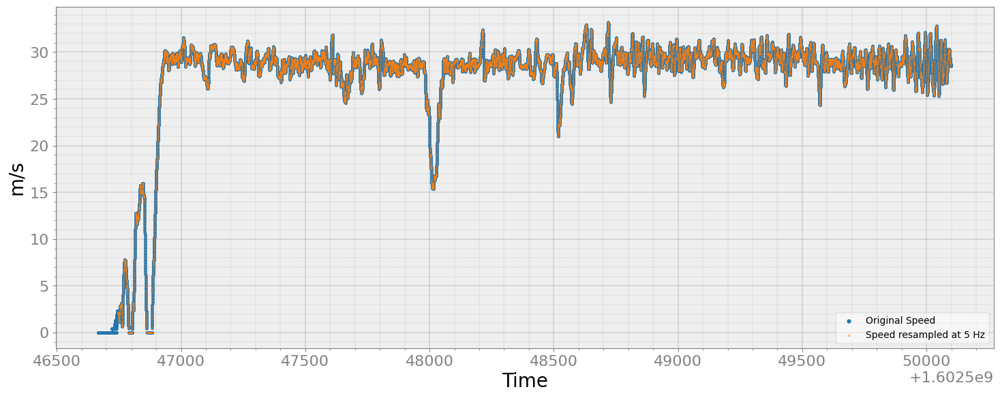

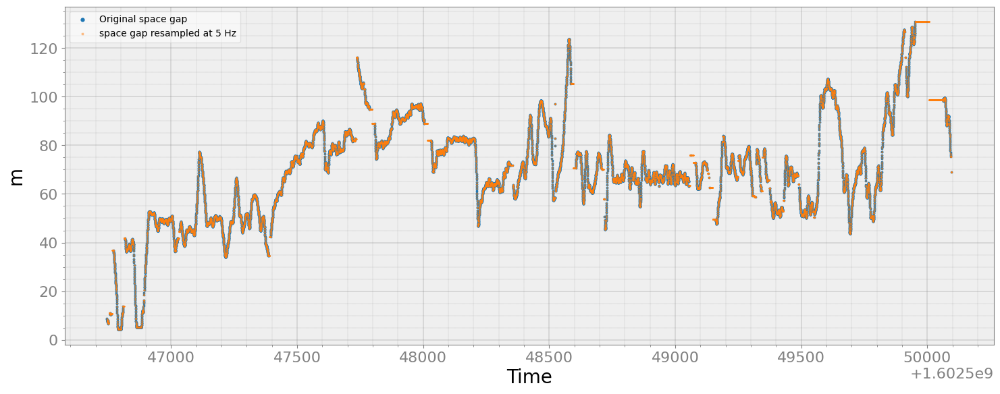

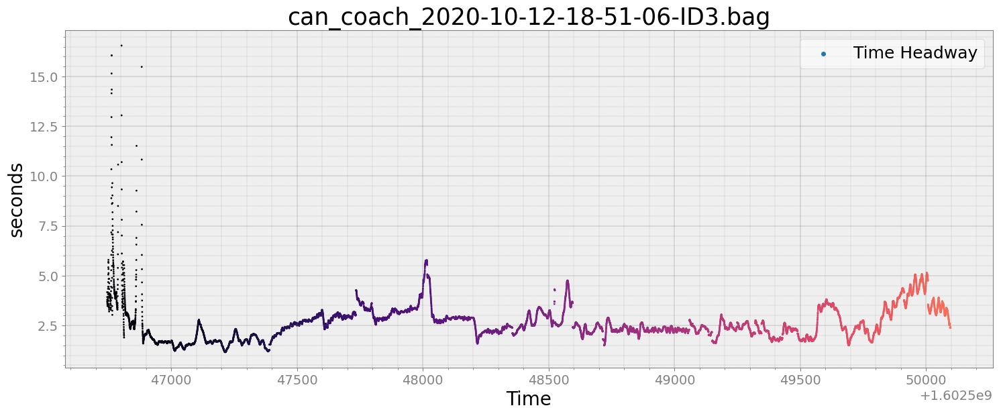

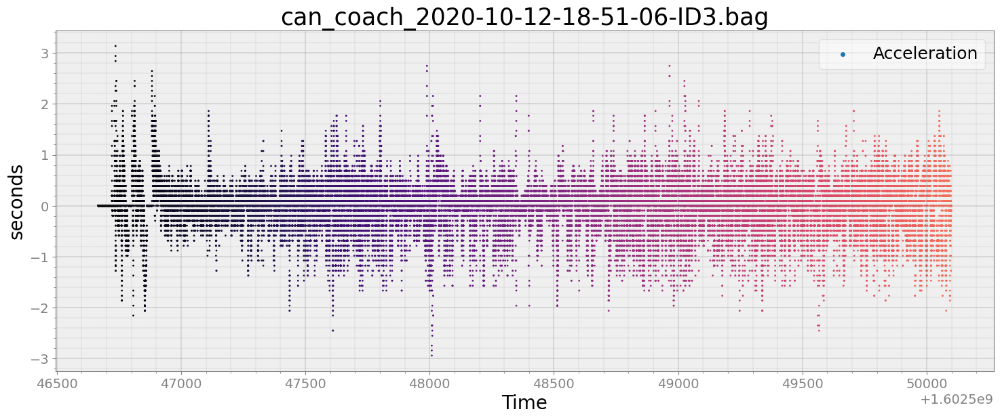

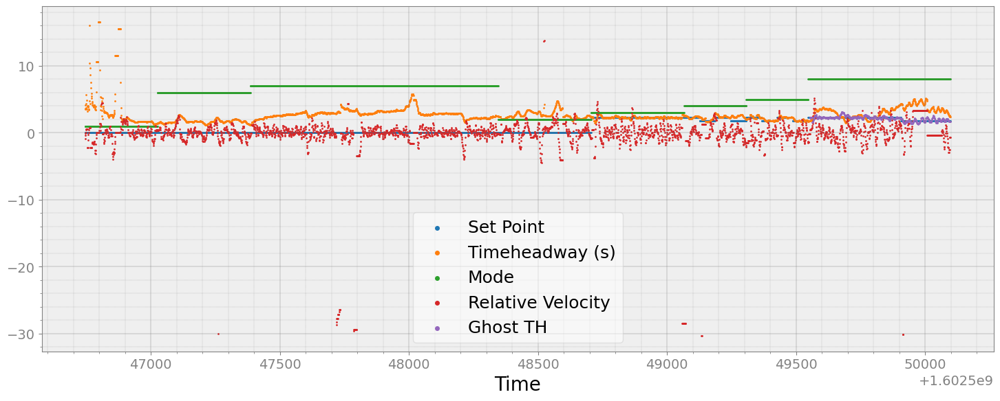

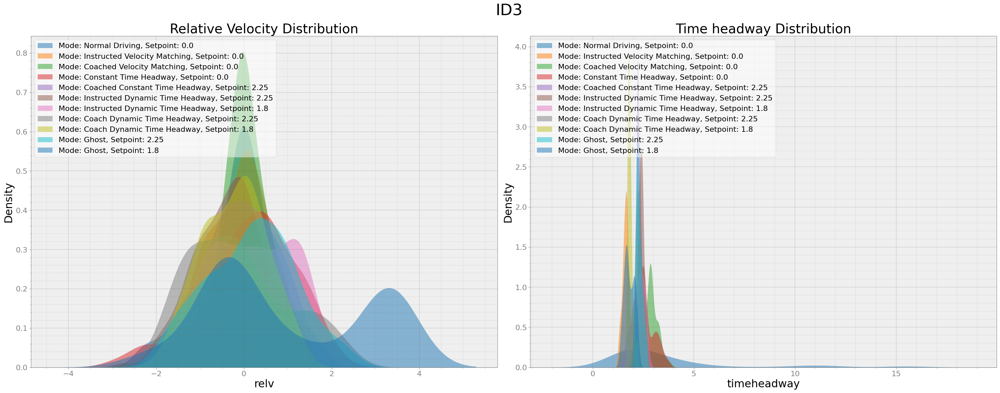

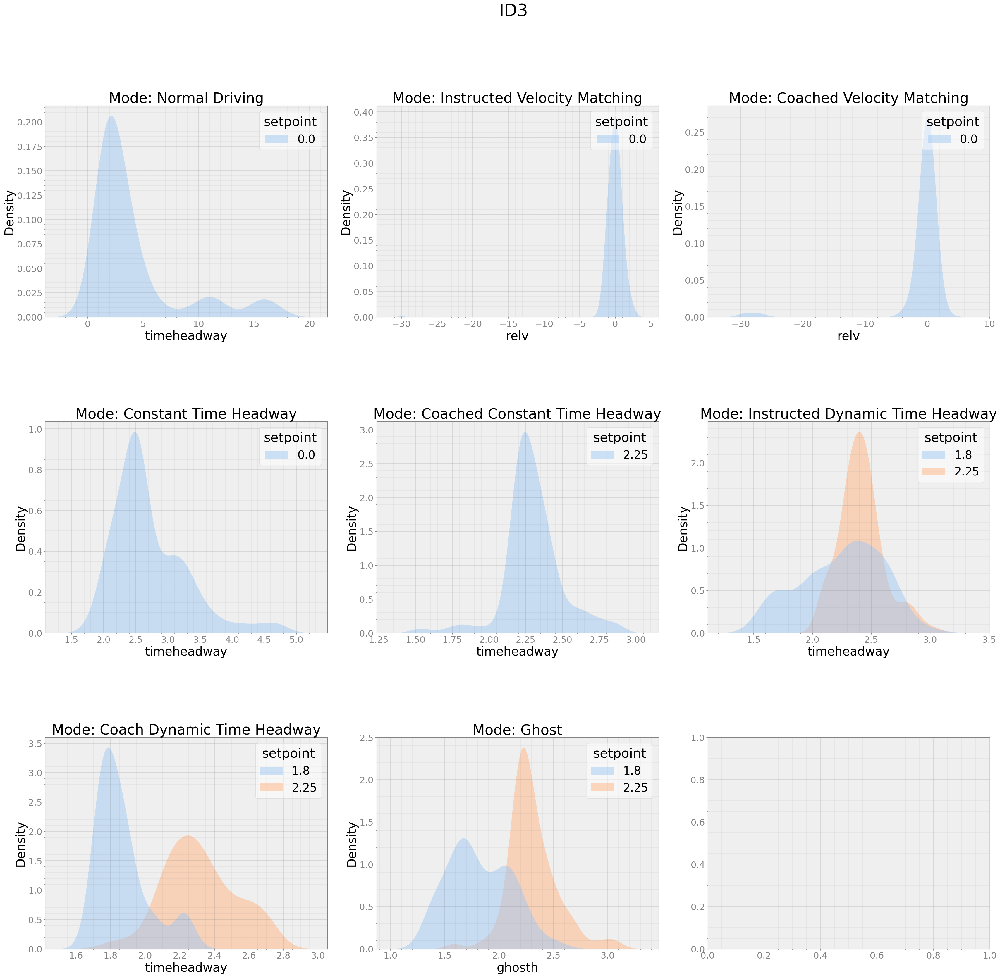

In [10]:
th_kde_plot(b2)

### Bag File with ID-4
### Time headway plot, KDE plot

Analyzing Timestamp and Data Rate of Speed
Interquartile Range of Rate for Speed is 7.308168848177637 


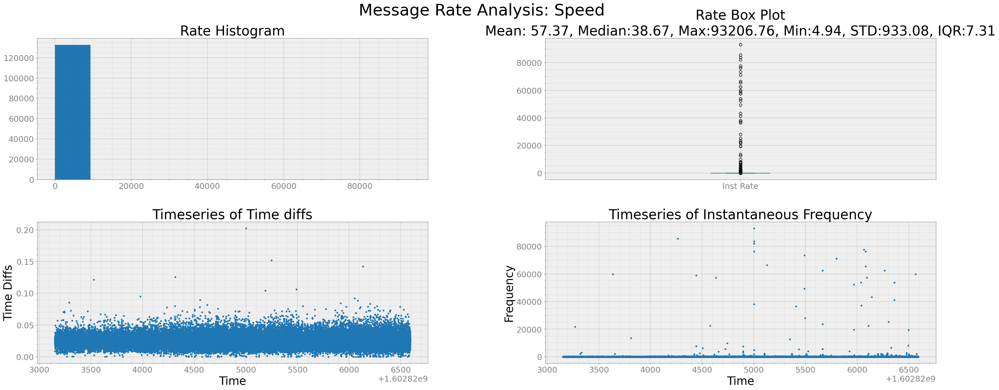

Analyzing Timestamp and Data Rate of Space Gap
Interquartile Range of Rate for Space Gap is 0.25073438079693666 


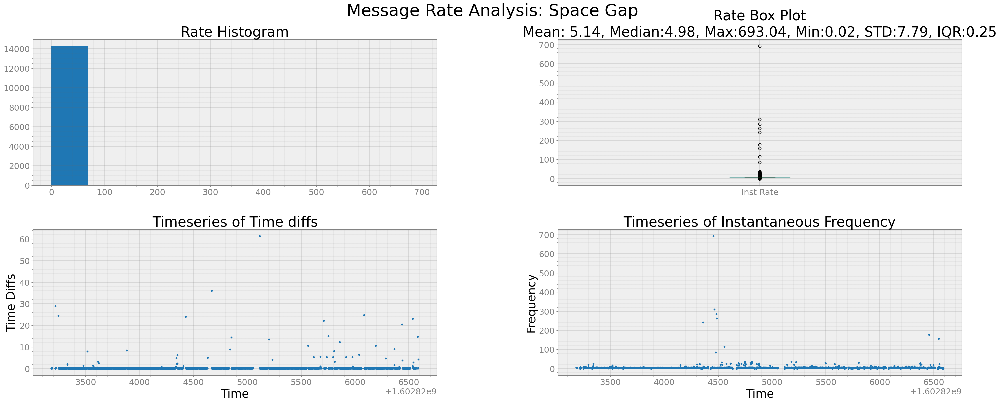

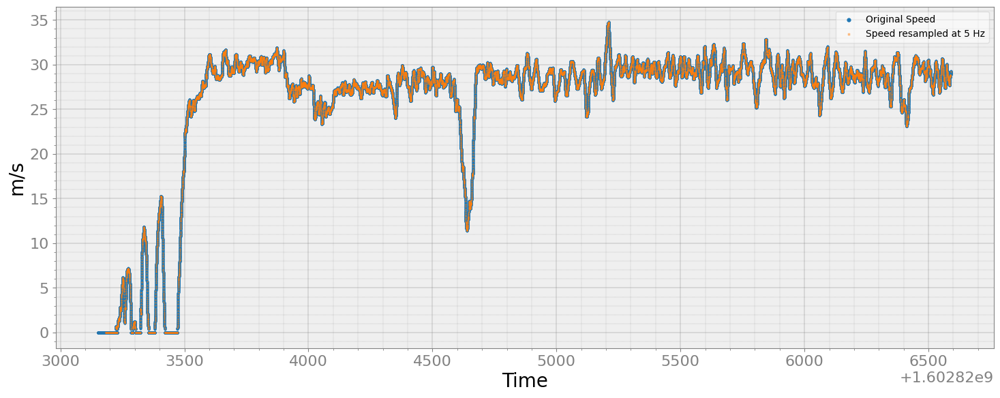

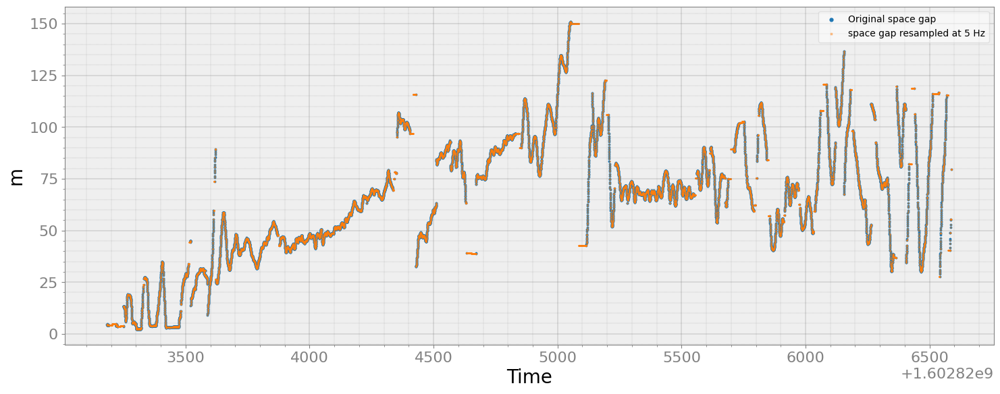

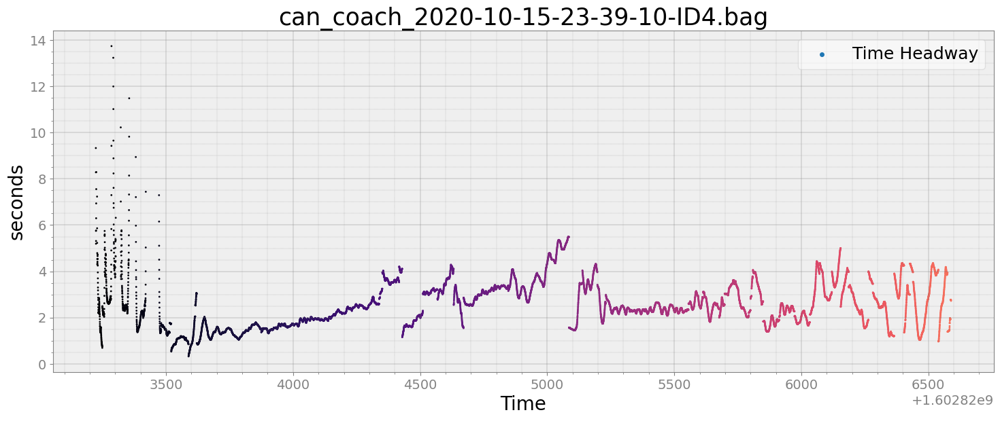

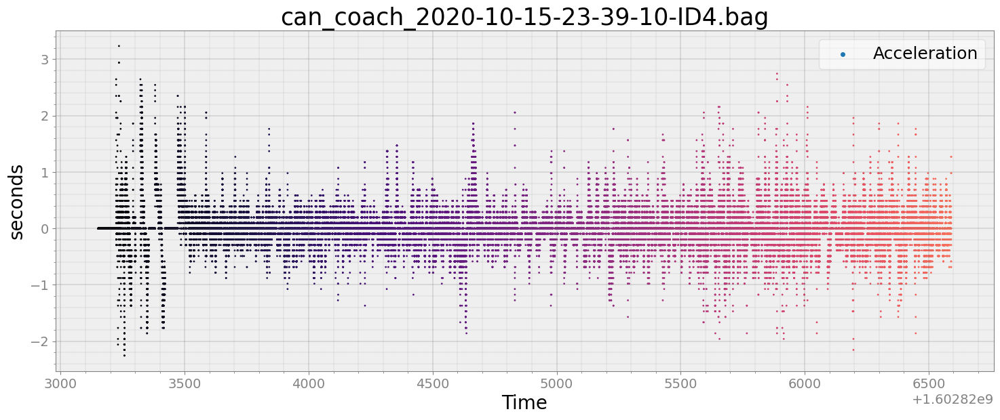

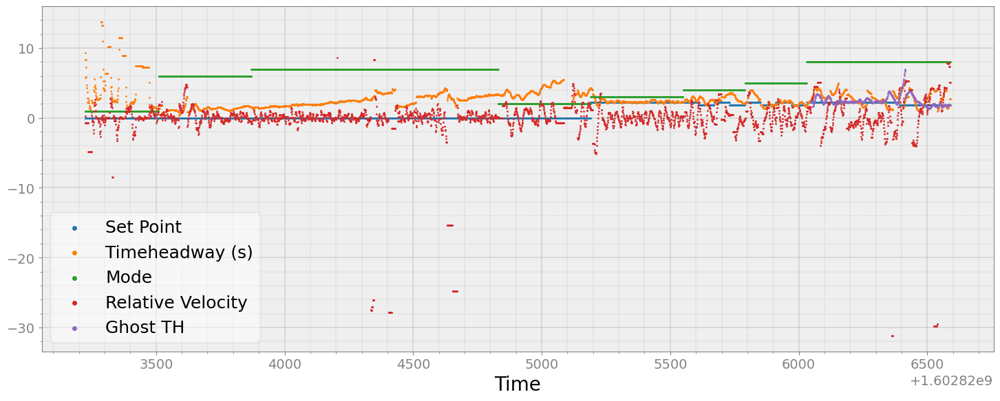

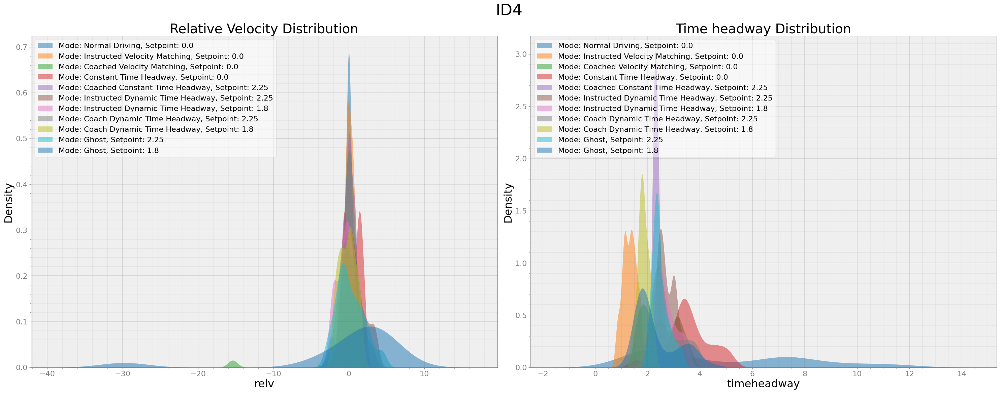

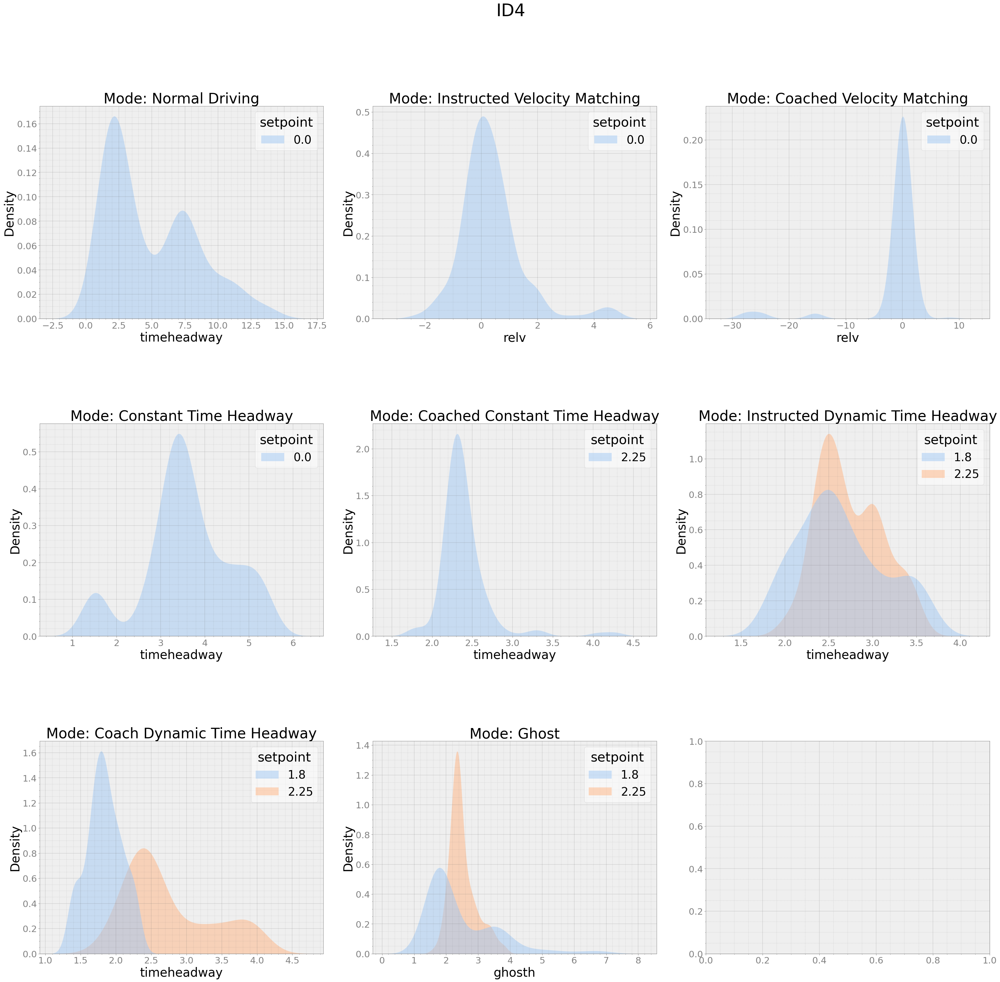

In [11]:
th_kde_plot(b3)

### Bag File with ID-5
### Time headway plot, KDE plot

Analyzing Timestamp and Data Rate of Speed
Interquartile Range of Rate for Speed is 7.205939177974905 


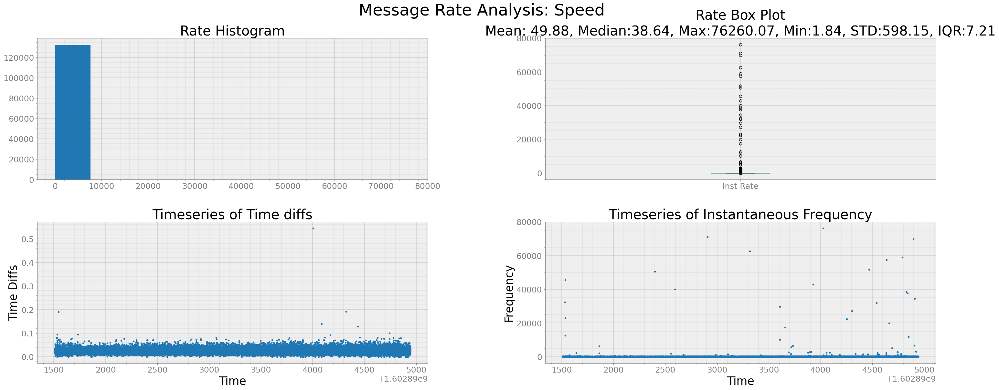

Analyzing Timestamp and Data Rate of Space Gap
Interquartile Range of Rate for Space Gap is 0.22491536733498574 


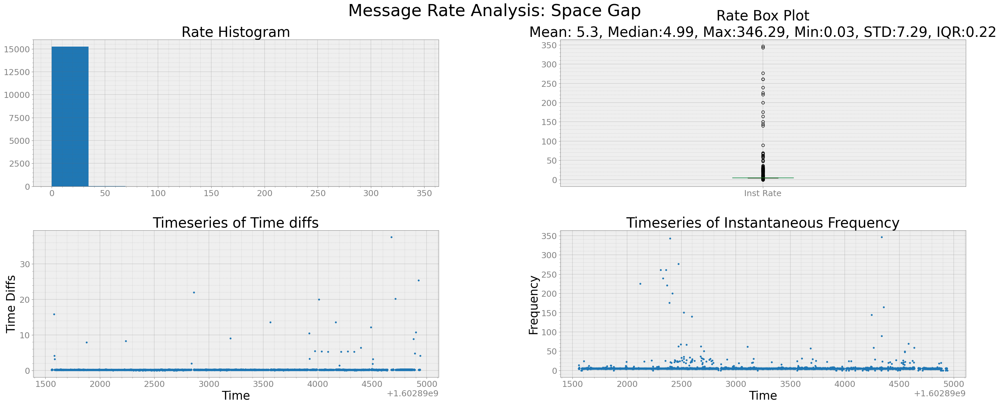

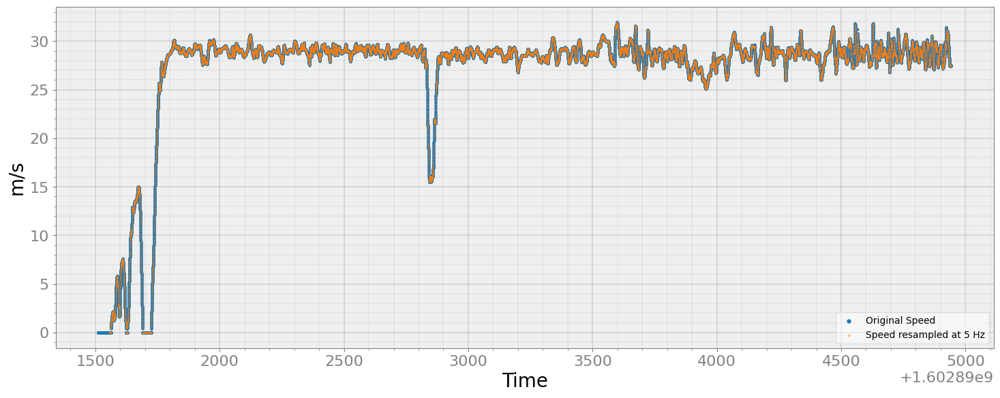

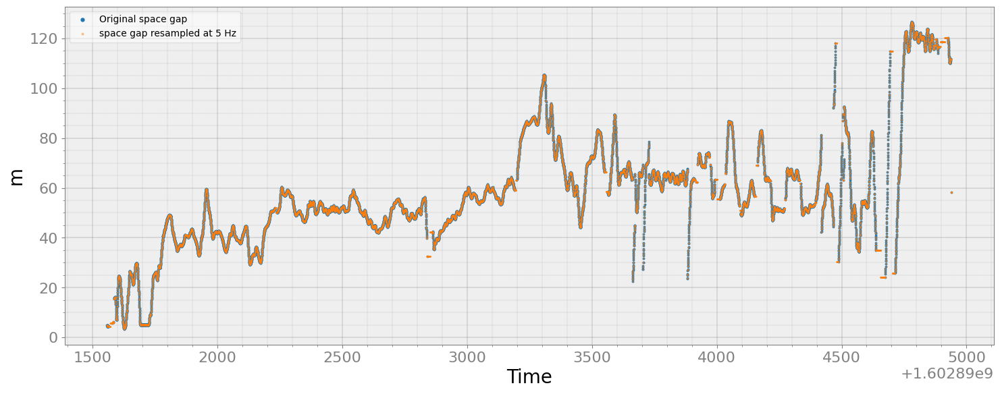

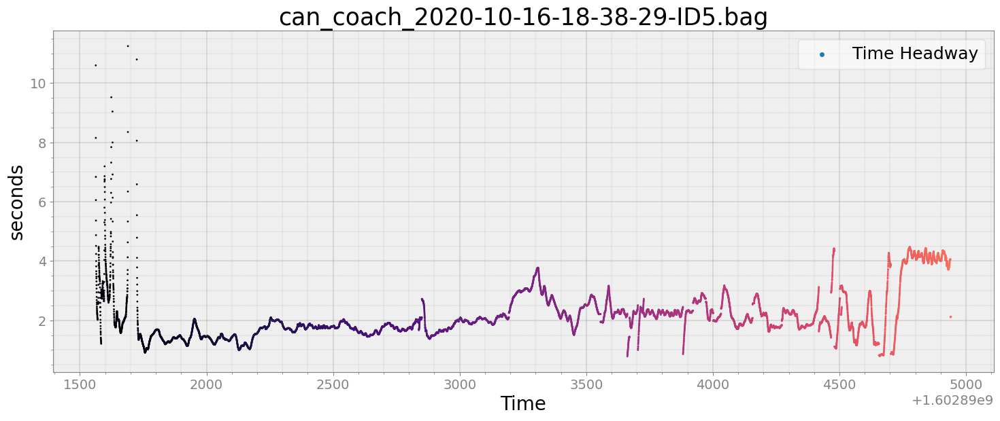

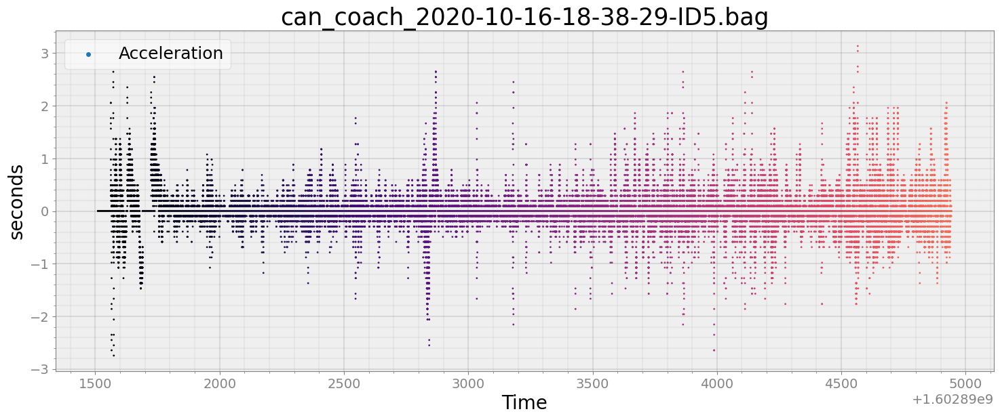

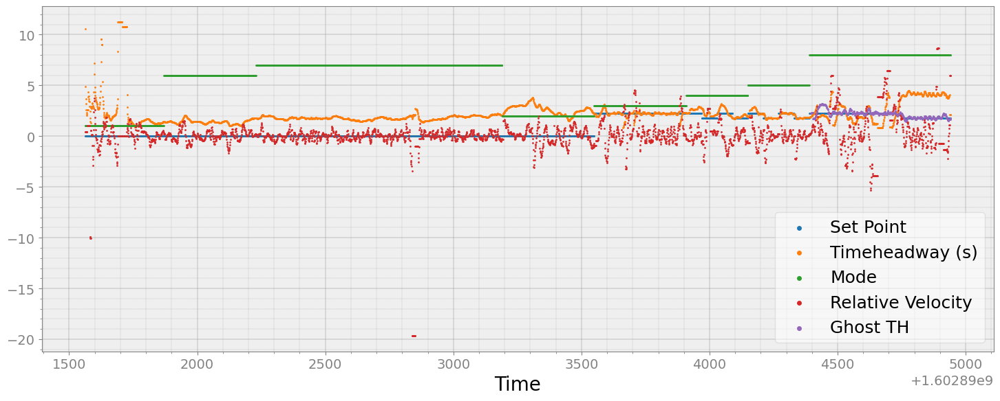

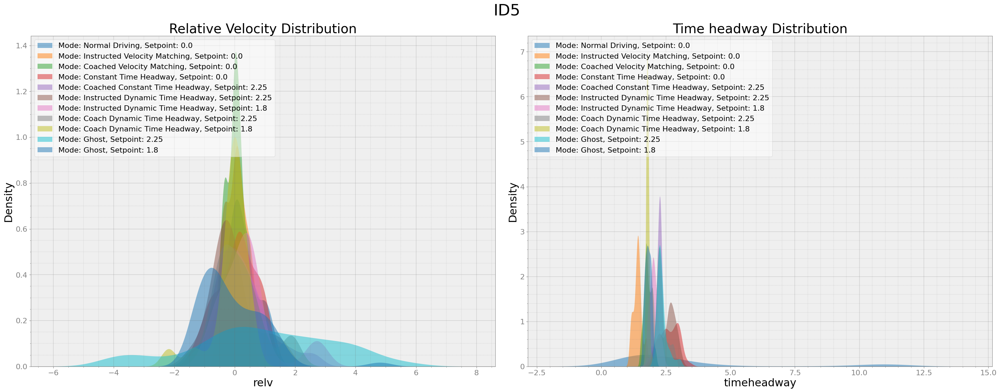

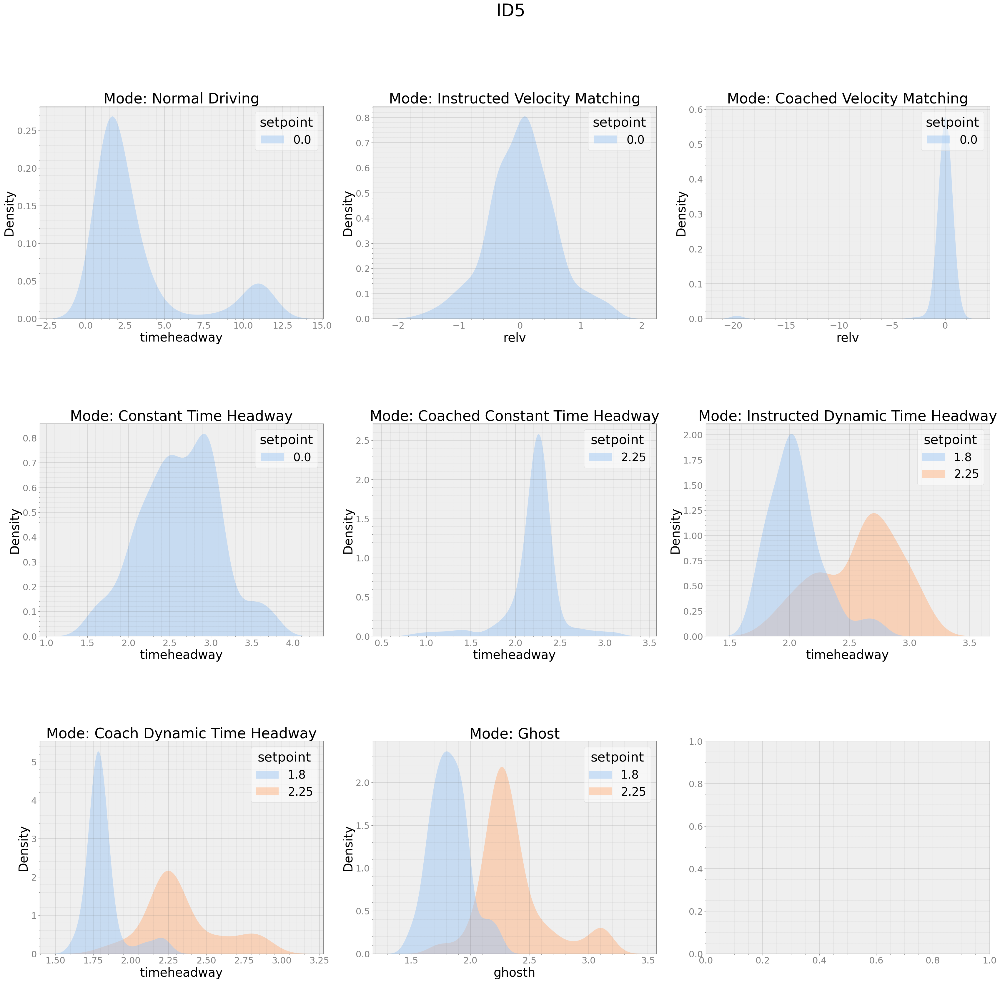

In [12]:
th_kde_plot(b4)

### Bag File with ID-6
### Time headway plot, KDE plot

Analyzing Timestamp and Data Rate of Speed
Interquartile Range of Rate for Speed is 9.214940913105295 


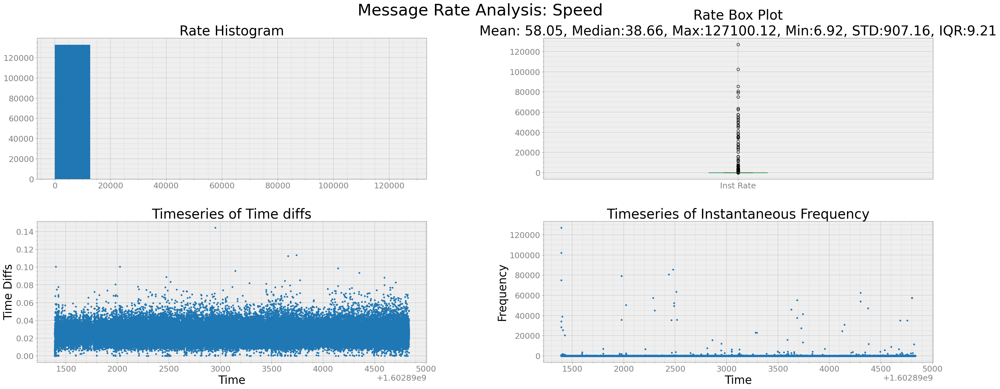

Analyzing Timestamp and Data Rate of Space Gap
Interquartile Range of Rate for Space Gap is 0.2826590389510901 


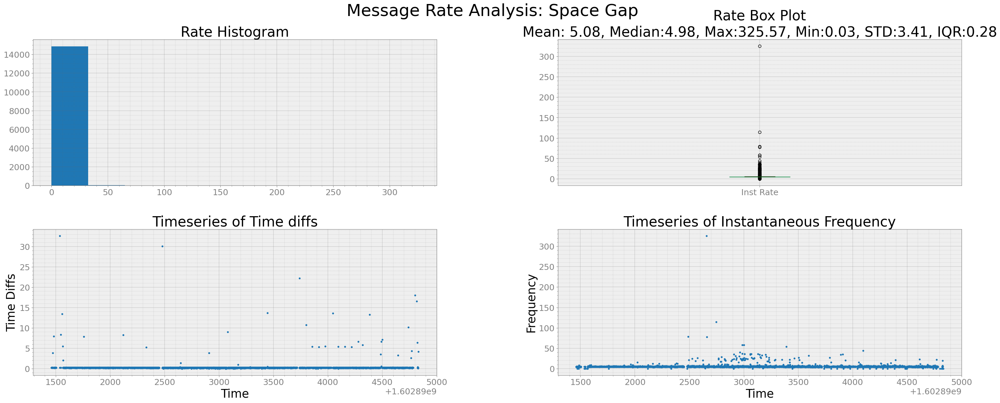

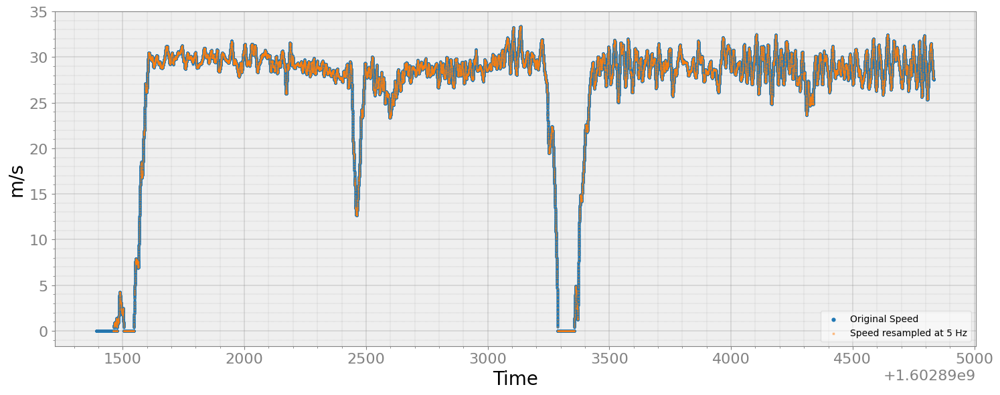

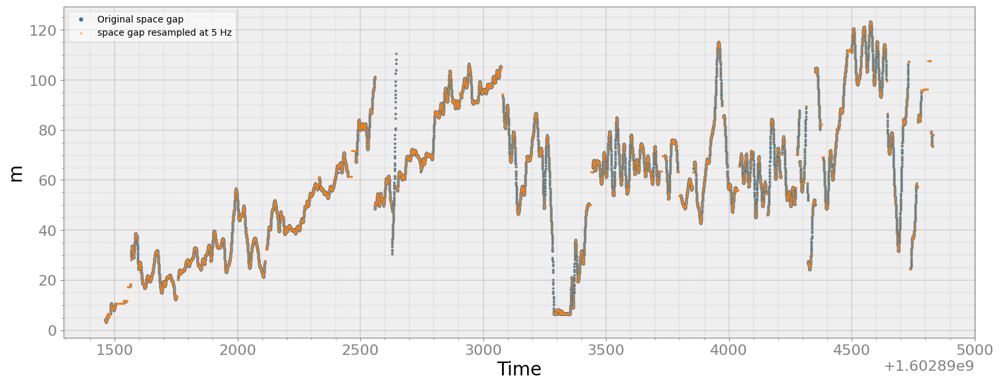

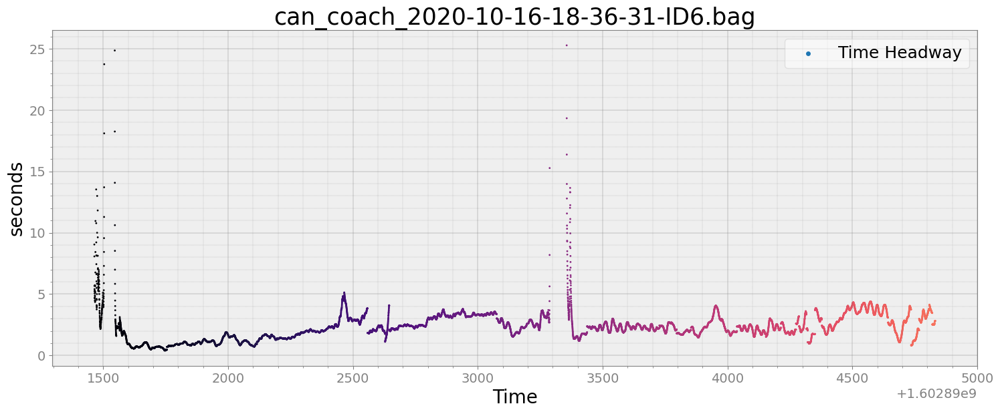

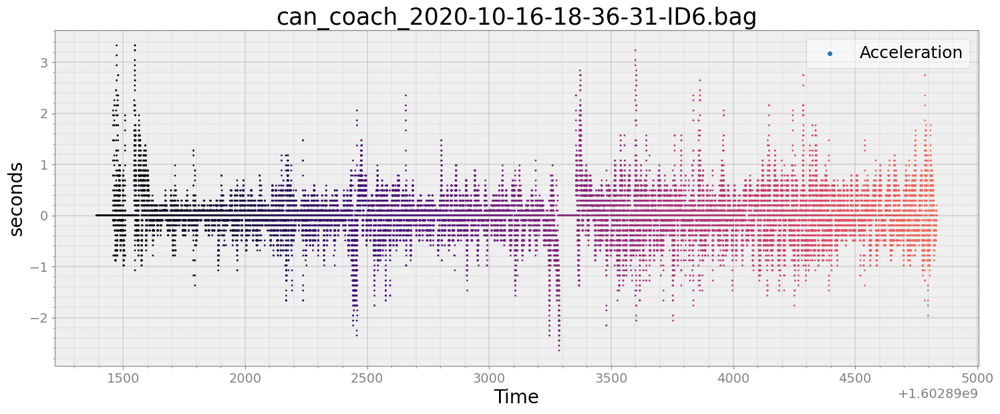

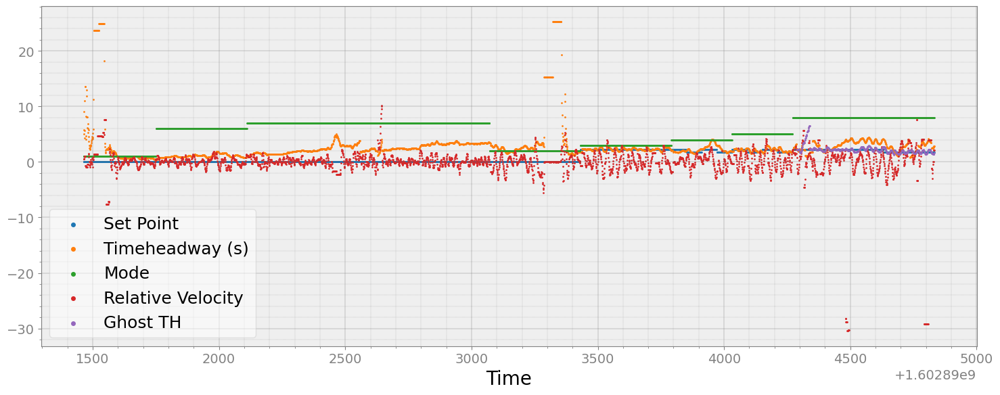

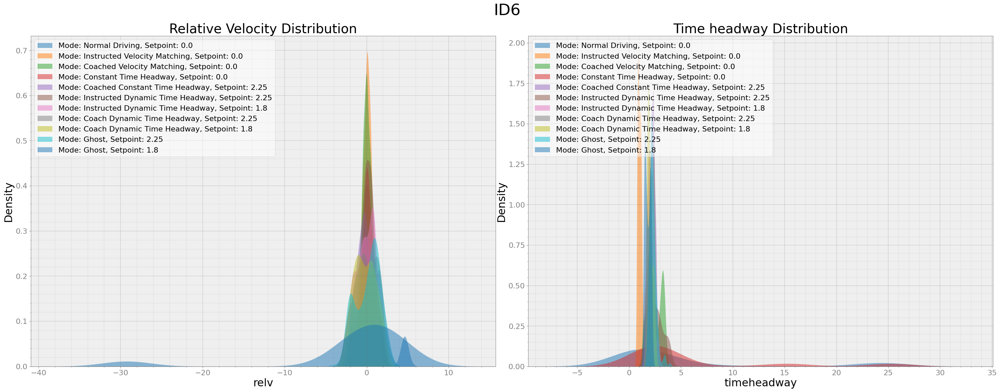

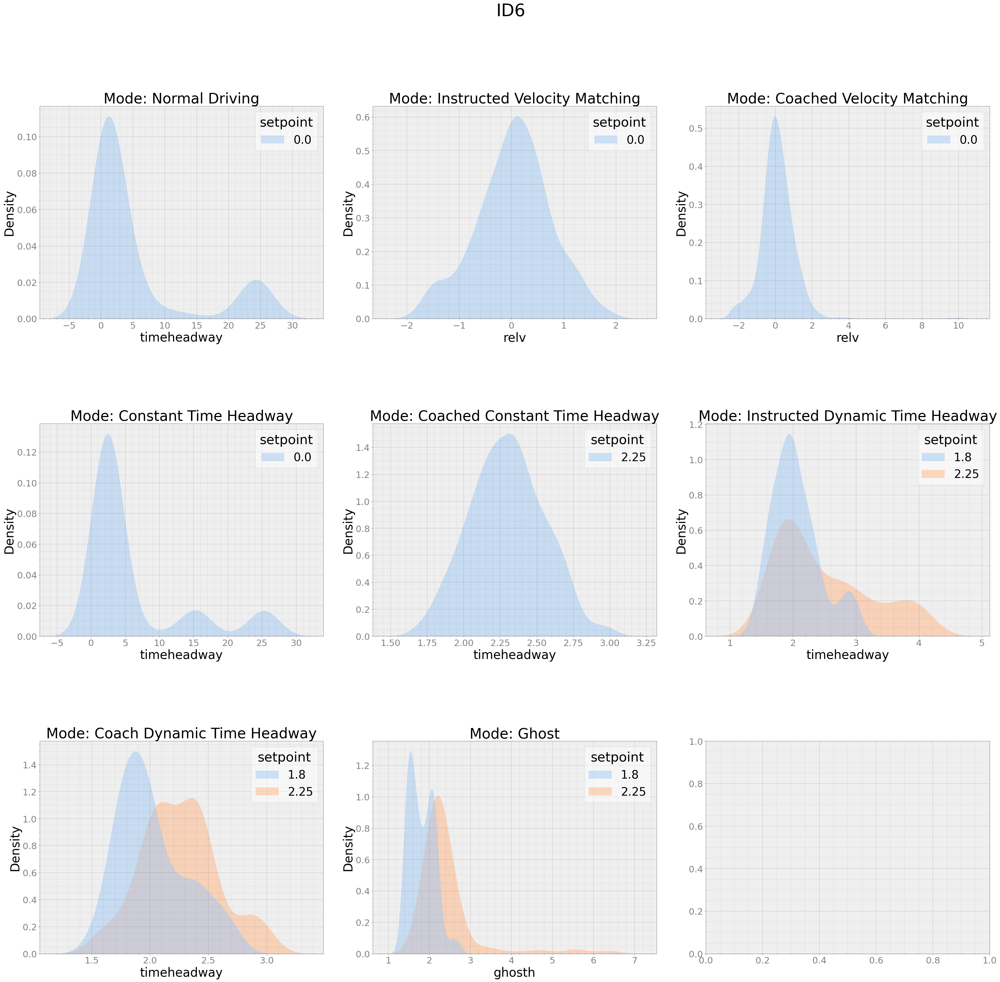

In [13]:
th_kde_plot(b5)

## Aggregated plot

(2821, 11)
(2862, 11)
(2861, 11)
(2849, 11)
(2866, 11)
(2854, 11)


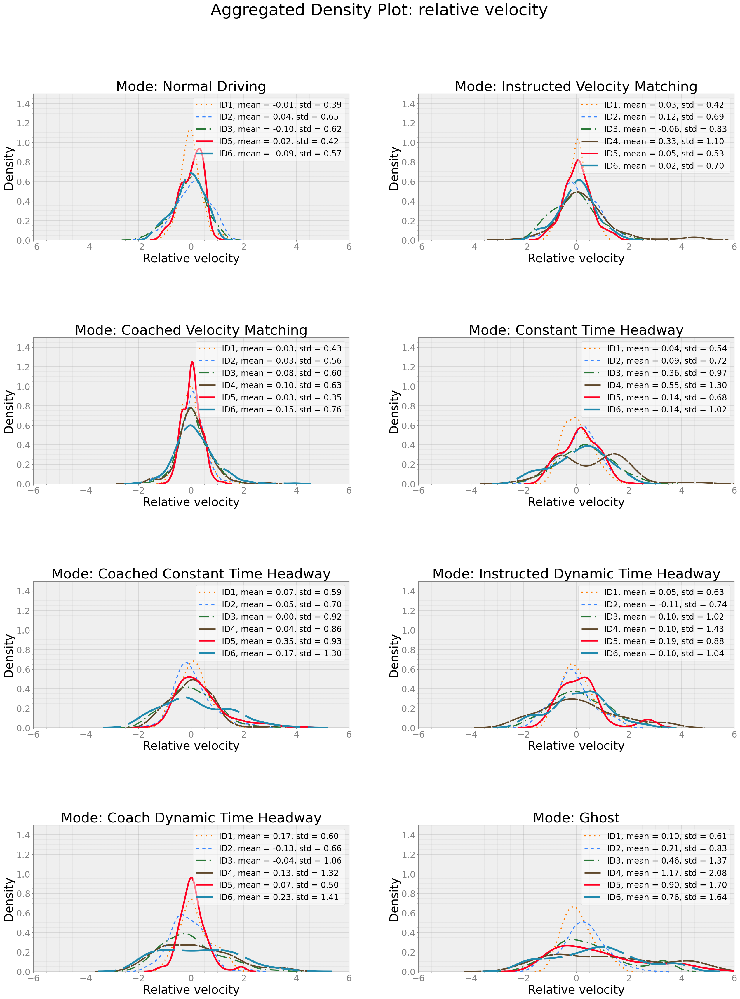

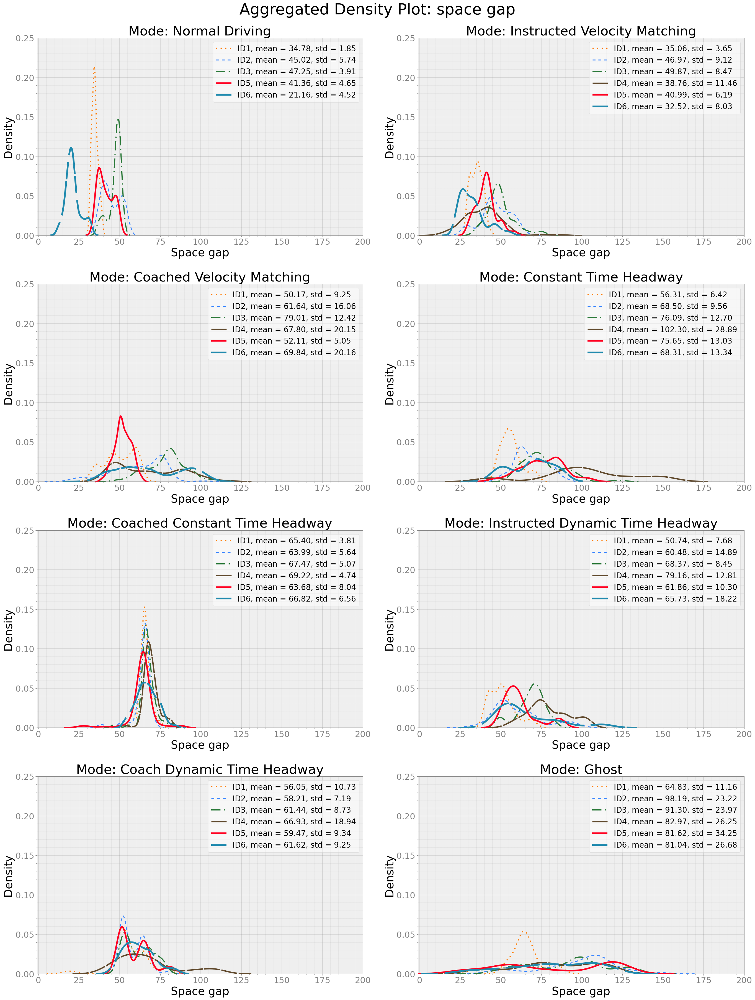

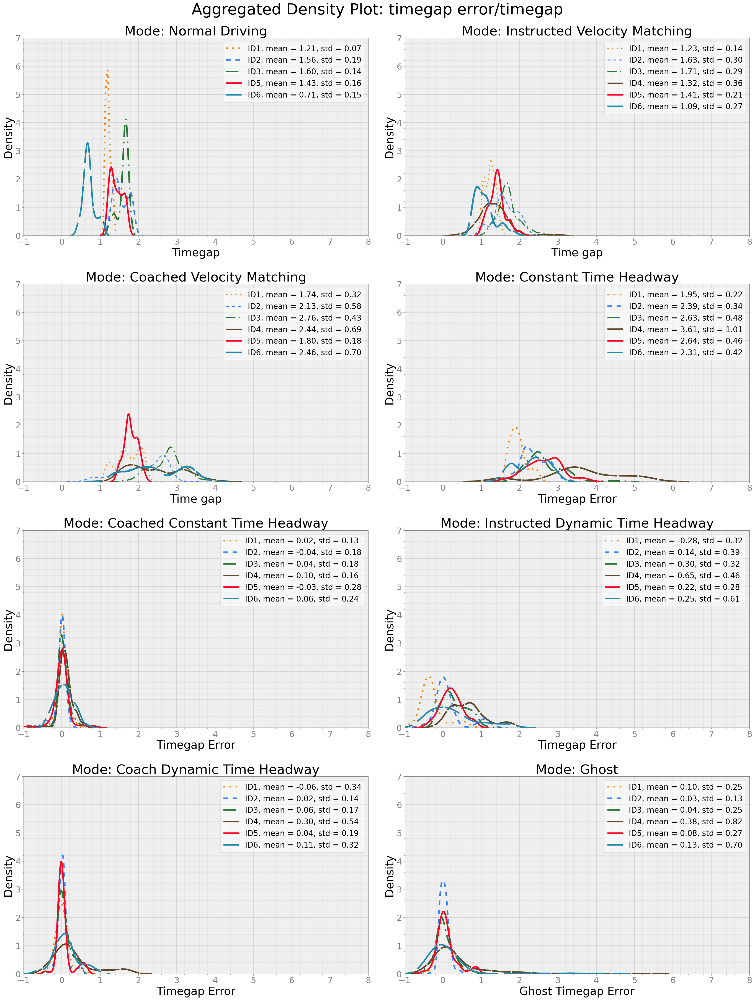

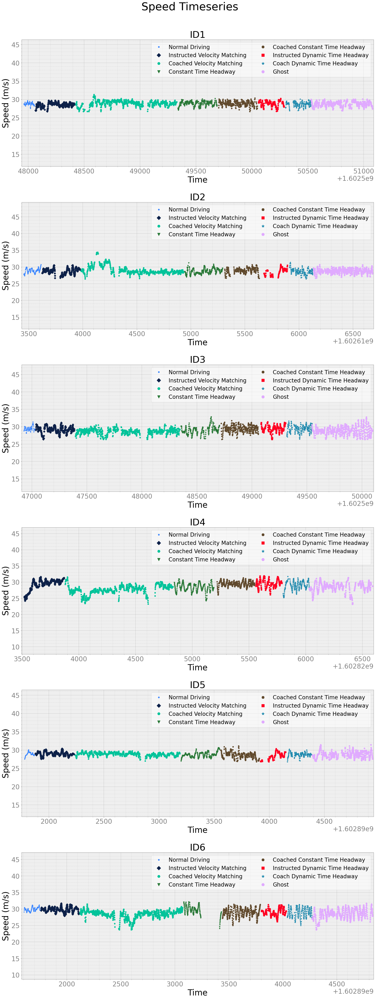

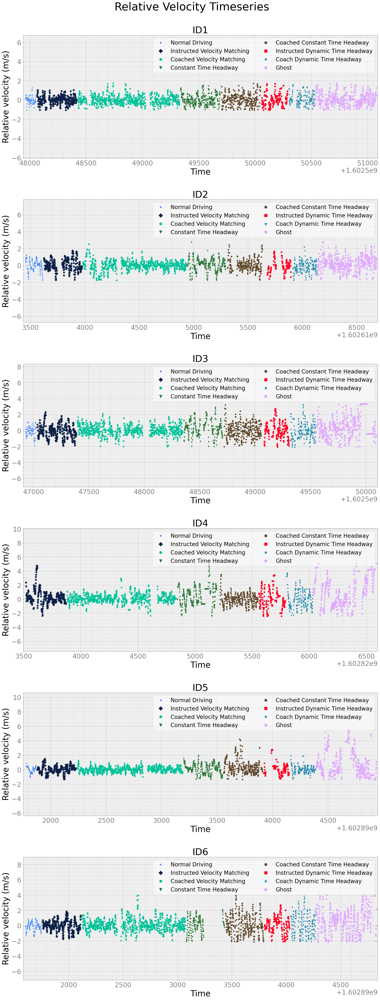

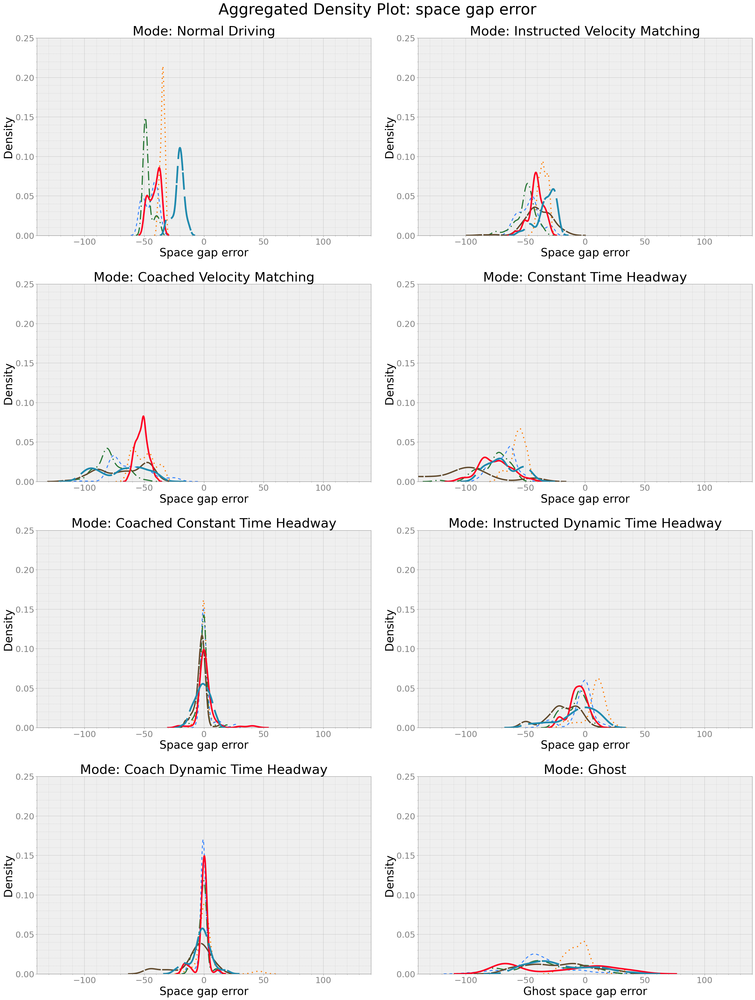

In [83]:
data = multi_bag_kde([b0, b1, b2, b3, b4, b5])

In [84]:
data

,Time,setpoint,timeheadway,mode,relv,ghosth,spacegap,speed,ghostvel,desired_spacegap,spacegap_error
Clock,,,,,,,,,,,
2020-10-16 23:39:51.282717705,1.602892e+09,0.0,1.502434,1.0,-0.925,NaN,37.080072,24.690001,NaN,0.000000,-37.080072
2020-10-16 23:39:52.283246994,1.602892e+09,0.0,1.382421,1.0,-1.900,NaN,35.680290,25.879999,NaN,0.000000,-35.680290
2020-10-16 23:39:55.284835100,1.602892e+09,0.0,1.042842,1.0,-2.075,NaN,27.520610,26.360001,NaN,0.000000,-27.520610
2020-10-16 23:39:56.285364389,1.602892e+09,0.0,0.975708,1.0,-1.400,NaN,25.680635,26.320000,NaN,0.000000,-25.680635
2020-10-16 23:39:57.285893917,1.602892e+09,0.0,0.943960,1.0,-0.900,NaN,24.760064,26.240000,NaN,0.000000,-24.760064
2020-10-16 23:39:58.286423206,1.602892e+09,0.0,0.933636,1.0,0.050,NaN,24.479924,26.209999,NaN,0.000000,-24.479924
2020-10-16 23:39:59.286952496,1.602892e+09,0.0,0.939661,1.0,0.525,NaN,24.919803,26.540001,NaN,0.000000,-24.919803
2020-10-16 23:40:00.287481785,1.602892e+09,0.0,0.946583,1.0,0.850,NaN,25.519863,27.020000,NaN,0.000000,-25.519863
2020-10-16 23:40:01.288011074,1.602892e+09,0.0,0.955598,1.0,0.750,NaN,26.479609,27.760000,NaN,0.000000,-26.479609
